In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import scipy.stats as stats
from scipy import signal
from scipy.stats import rankdata

from statsmodels.graphics.tsaplots import acf, pacf, plot_acf, plot_pacf
#from pmdarima.arima import ADFTest, KPSSTest, ndiffs, auto_arima
from statsmodels.tsa.stattools import adfuller, kpss
from statsmodels.stats.diagnostic import acorr_ljungbox
#from arch import arch_model
from statsmodels.graphics import tsaplots
from sklearn.decomposition import PCA
import statsmodels.api as sm

import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader
import torch.nn.init as init
import torch.nn.functional as F

from google.colab import drive
from tqdm import tqdm
import yfinance as yf
from itertools import combinations

In [ ]:
#fix pmdarima issue
#!pip install arch
#!pip cache purge
#!pip install --upgrade --force-reinstall pmdarima 'numpy<2' pandas==2.2.2 jedi


In [2]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [36]:
root_dir = '/content/drive/My Drive/kaggle_tokyo_stock_market_pred'

#read content from drive
stock_prices = pd.read_csv(f'{root_dir}/train_files/stock_prices.csv')
financial_statements = pd.read_csv(f'{root_dir}/train_files/financials.csv')
#options = pd.read_csv(f'{root_dir}/train_files/options.csv')
trades = pd.read_csv(f'{root_dir}/train_files/trades.csv')
stock_list = pd.read_csv(f'{root_dir}/stock_list.csv')
options_spec = pd.read_csv(f'{root_dir}/data_specifications/options_spec.csv')
stock_price_spec =pd.read_csv(f'{root_dir}/data_specifications/stock_price_spec.csv')
stock_list_spec = pd.read_csv(f'{root_dir}/data_specifications/stock_list_spec.csv')
stock_fin_spec = pd.read_csv(f'{root_dir}/data_specifications/stock_fin_spec.csv')
#trades_spec = pd.read_csv(f'{root_dir}/data_specifications/trades_spec.csv')
macro_data = pd.read_excel(f'{root_dir}/szakdolgozat_adat.xlsx')


<ipython-input-36-46a8200cf93f>:5: DtypeWarning: Columns (14,15,16,17,18,19,42,44) have mixed types. Specify dtype option on import or set low_memory=False.
  financial_statements = pd.read_csv(f'{root_dir}/train_files/financials.csv')


# Preprocessing

In [5]:
#filter date range to full series
min_dates = stock_prices.groupby('SecuritiesCode')['Date'].min()
valid_min= min_dates[pd.to_datetime(min_dates) <= pd.to_datetime('2017-01-05')].index

max_dates = stock_prices.groupby('SecuritiesCode')['Date'].max()
valid_max= max_dates[pd.to_datetime(max_dates) >= pd.to_datetime('2021-12-01')].index

valid_dates = valid_min.intersection(valid_max)
stock_prices = stock_prices[stock_prices['SecuritiesCode'].isin(valid_dates)]


In [6]:
#map with names
stock_prices = pd.merge(stock_prices, stock_list[['SecuritiesCode', '17SectorName','Name']], on='SecuritiesCode', how='left')
stock_prices = stock_prices.rename(columns={'17SectorName':'SectorName'})
#stock_prices['log_return'] = pd.to_numeric(stock_prices['log_return'], errors='coerce')

#add returns and log returns
stock_prices['return'] = stock_prices.groupby('SecuritiesCode')['Close'].transform(lambda x: x / x.shift(1)-1)
stock_prices['log_return'] = stock_prices.groupby('SecuritiesCode')['Close'].transform(lambda x: np.log(x / x.shift(1)))

# Drop rows where log_return is NaN (first row per group)
stock_prices = stock_prices.dropna(subset=["log_return"]).reset_index(drop=True)
stock_prices['Date'] = pd.to_datetime(stock_prices['Date'])

In [37]:
#macro_data = pd.read_excel(f'{root_dir}/szakdolgozat_adat.xlsx')

macro_data = macro_data[
    (macro_data['Date'] >= pd.to_datetime('2017-01-05')) &
    (macro_data['Date'] <= pd.to_datetime('2021-12-01'))
]

macro_data = macro_data.sort_values(by='Date', ascending=True).reset_index(drop=True)
macro_data = macro_data.ffill()
#macro_data.dropna(axis=1, inplace=True)
macro_data['nikkei_log_return'] = np.log(macro_data['nikkei_225_index'] / macro_data['nikkei_225_index'].shift(1))
macro_data.dropna(inplace = True)
macro_data.set_index('Date', inplace=True)
macro_data.drop(columns = ['tibor_3m'], inplace = True)

In [8]:
sector_stocks = stock_prices[stock_prices['SectorName'] == 'IT & SERVICES, OTHERS ']
piv_table = sector_stocks.pivot(index='Date', columns='SecuritiesCode', values=['High', 'Low', 'Close', 'Volume','log_return'])

In [9]:
piv_table = piv_table.sort_index(axis=1, level=0)
piv_table.head(1)

Close                                                        \
SecuritiesCode    1954    1973   2120    2121    2124    2127   2130    2146   
Date                                                                           
2017-01-05      2654.0  2188.0  823.0  4435.0  1384.0  3300.0  601.0  1004.0   

                              ... log_return                                \
SecuritiesCode   2148   2150  ...       9769      9783      9787      9788   
Date                          ...                                            
2017-01-05      632.0  785.0  ...   0.006038  0.007582  0.020803  0.002016   

                                                                           
SecuritiesCode      9790      9793      9795      9889      9928     9984  
Date                                                                       
2017-01-05      0.060161  0.001627  0.022376  0.024282  0.033939  0.01957  

[1 rows x 1990 columns]

## Analyzing missing data


In [ ]:
piv_table.loc[:, piv_table.isna().any(axis=0)]

High                                                  \
SecuritiesCode    2150    2185    2349    3628    3733    3854    3915   
Date                                                                     
2017-01-05       798.0  3315.0  3950.0  1735.0  5580.0   828.0  5510.0   
2017-01-06       799.0  3305.0  3860.0  1743.0  5450.0   835.0  5520.0   
2017-01-10       807.0  3305.0  3950.0  1718.0  5350.0   840.0  5500.0   
2017-01-11       840.0  3305.0  3950.0  1784.0  5300.0   834.0  5400.0   
2017-01-12       838.0  3305.0  3875.0  1780.0  5270.0   828.0  5270.0   
...                ...     ...     ...     ...     ...     ...     ...   
2021-11-29      1174.0  1340.0  1560.0  2044.0  6340.0  1609.0  2177.0   
2021-11-30      1153.0  1369.0  1540.0  1977.0  6350.0  1623.0  2177.0   
2021-12-01      1075.0  1425.0  1527.0  1928.0  6330.0  1587.0  2075.0   
2021-12-02      1048.0  1376.0  1519.0  1870.0  6260.0  1569.0  2025.0   
2021-12-03      1030.0  1340.0  1518.0  1952.0  6300.0  1590.0  1984.0   

                                        ... log_return                      \
SecuritiesCode    4327    4699    4771  ...       4771      4781      4832   
Date                                    ...                                  
2017-01-05      3170.0  1140.0   927.0  ...  -0.007580  0.001599  0.026569   
2017-01-06      3140.0  1119.0   919.0  ...  -0.014231 -0.009631 -0.000610   
2017-01-10      3150.0  1094.0   908.0  ...   0.000000  0.000000 -0.024083   
2017-01-11      3155.0  1066.0   909.0  ...  -0.004420 -0.008097  0.024693   
2017-01-12      3150.0  1110.0   903.0  ...  -0.006667  0.016129 -0.005503   
...                ...     ...     ...  ...        ...       ...       ...   
2021-11-29      2375.0  2053.0  2091.0  ...  -0.041452 -0.000935  0.007052   
2021-11-30      2385.0  2049.0  2100.0  ...  -0.015873  0.003735  0.010753   
2021-12-01      2398.0  2050.0  1999.0  ...  -0.018164  0.000000  0.015389   
2021-12-02      2385.0  2149.0  1927.0  ...  -0.072855  0.000932 -0.020751   
2021-12-03      2400.0  2180.0  1968.0  ...   0.074890  0.013870  0.019170   

                                                                            \
SecuritiesCode      7879      8157      9441      9631      9640      9661   
Date                                                                         
2017-01-05     -0.002853  0.113329 -0.003892  0.000000  0.040056  0.001970   
2017-01-06      0.021202  0.000000  0.036203  0.005051  0.039317  0.001967   
2017-01-10      0.005579 -0.007794  0.007154 -0.001260  0.023026       NaN   
2017-01-11      0.109247 -0.015773 -0.019192  0.006285 -0.012638       NaN   
2017-01-12     -0.002497 -0.014412 -0.014288 -0.001254 -0.033134  0.001967   
...                  ...       ...       ...       ...       ...       ...   
2021-11-29     -0.101704 -0.024111       NaN -0.009950 -0.005625 -0.005277   
2021-11-30     -0.044784  0.000581  0.007566  0.003992  0.000513  0.004224   
2021-12-01     -0.017972  0.004057  0.000000  0.003976 -0.000513 -0.004224   
2021-12-02      0.010309  0.002888  0.018669 -0.005970  0.000000 -0.006369   
2021-12-03     -0.005141  0.019418 -0.033859 -0.002999 -0.002567  0.001064   

                          
SecuritiesCode      9687  
Date                      
2017-01-05     -0.001681  
2017-01-06      0.003359  
2017-01-10      0.008347  
2017-01-11      0.005802  
2017-01-12     -0.002482  
...                  ...  
2021-11-29      0.007055  
2021-11-30     -0.002640  
2021-12-01     -0.001322  
2021-12-02     -0.003093  
2021-12-03     -0.011124  

[1199 rows x 95 columns]

In [10]:
na_cols = piv_table.loc[:, piv_table.isna().any(axis=0)]
na_rows = piv_table.isna()
na_rows = na_rows[na_rows == True]

Text(0.5, 0, 'Column Number')

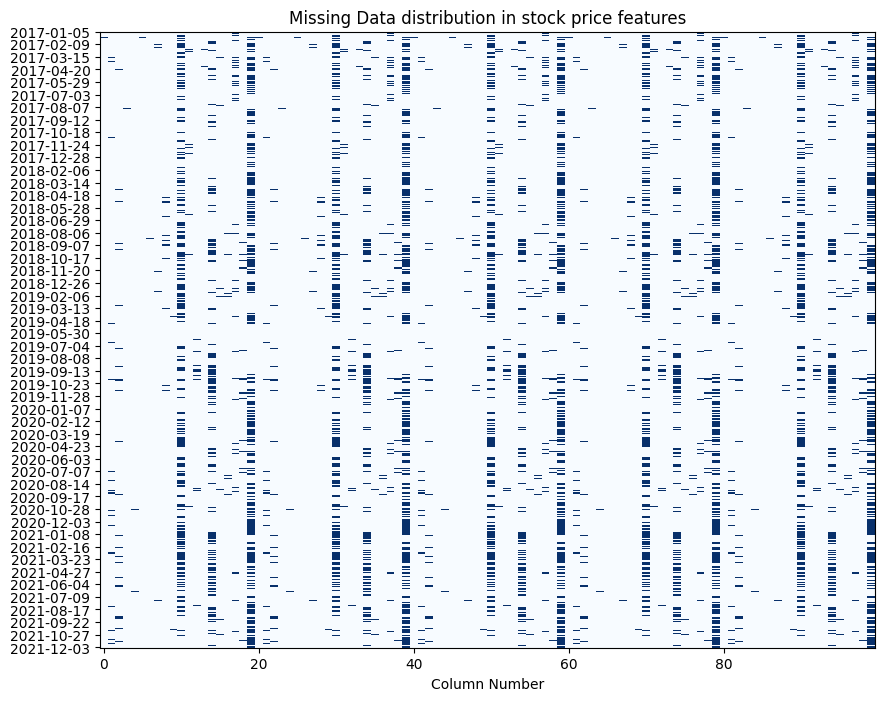

In [11]:
#plot missing data
plt.figure(figsize=(10, 8))
plt.imshow(na_cols.isna(), aspect="auto", interpolation="nearest", cmap="Blues")
# Show selected datetime labels on y-axis to avoid clutter
plt.yticks(
    ticks=np.linspace(0, len(na_cols.index) - 1, 50, dtype=int),
    labels=na_cols.index[np.linspace(0, len(na_cols.index) - 1, 50, dtype=int)].date
)

plt.title('Missing Data distribution in stock price features')
plt.xlabel("Column Number")

## Dropping columns with larger than 10% missing values
Simple forward/backwardfill for the rest

In [12]:
missing = na_cols.isnull().sum()/len(na_cols)
to_impute = missing[(missing > 0)&(missing < 0.25)].sort_values(ascending=False)
to_drop = missing[(missing > 0.25)].sort_values(ascending=False)
to_drop.index.names = ['Feature', 'SecuritiesCode']
print("Missing values:\n", to_drop)

Missing values:
 Feature     SecuritiesCode
Close       9733              0.452043
High        9733              0.452043
log_return  9733              0.452043
Low         9733              0.452043
Volume      9733              0.452043
Close       4781              0.358632
Low         4781              0.358632
High        4781              0.358632
Volume      4781              0.358632
log_return  4781              0.358632
dtype: float64


In [13]:
cols_to_drop = to_drop.index.get_level_values('SecuritiesCode')
cols_to_impute = to_impute.index.get_level_values('SecuritiesCode')
print(f"dropping {len(cols_to_drop)} columns:")
print(f'security IDs: {cols_to_drop.unique().tolist()}')
print(f"imputing {len(cols_to_impute)} columns:")
print(f'security IDs: {cols_to_impute.unique().tolist()}')

#selects all lvl0 index that belong to lvl1 indices that are in cols_to_drop
cleaned_data = piv_table.drop(columns=piv_table.loc[:, (slice(None), cols_to_drop)])

cleaned_data = cleaned_data.ffill()
cleaned_data = cleaned_data.bfill()


dropping 10 columns:
security IDs: [9733, 4781]
imputing 90 columns:
security IDs: [9441, 9661, 2349, 2185, 9687, 4699, 7879, 4832, 9640, 9631, 4327, 8157, 4771, 3733, 2150, 3628, 3854, 3915]


In [38]:
# #add moving averages and slice missing values

for sec in cleaned_data["log_return"].columns:
    cleaned_data[("1m_ma", sec)] = cleaned_data["log_return", sec].rolling(window=21).mean()
    cleaned_data[("3m_ma", sec)] = cleaned_data["log_return", sec].rolling(window=63).mean()

cleaned_data = cleaned_data.iloc[63:]
macro_data = macro_data.iloc[63:]

# Statistical Time Series Analysis

In [ ]:
#I selected securities with the highest sharpe ratio
tech_stocks = cleaned_data.copy()
# log_returns is: DataFrame with daily log returns for each stock
log_returns = tech_stocks['log_return']

# Annualize using 252 trading days
avg_daily = log_returns.mean()
volatility = log_returns.std()
sharpe_ratio = avg_daily / volatility

# Convert log return to approximate arithmetic return: exp(μ) - 1
yearly_return = (avg_daily * 252).apply(np.exp) - 1
annual_volatility = volatility * np.sqrt(252)
annual_sharpe = (yearly_return) / annual_volatility

# Combine into DataFrame
stock_stats = pd.DataFrame({
    'Yearly Return': yearly_return,
    'Annual Volatility': annual_volatility,
    'Sharpe': annual_sharpe
})

# Apply filtering logic
longs = stock_stats[stock_stats['Yearly Return'] > 0].sort_values(by=['Sharpe', 'Annual Volatility'], ascending=[False, True]).head(4)
shorts = stock_stats[stock_stats['Yearly Return'] < 0].sort_values(by=['Sharpe', 'Annual Volatility'], ascending=[True, False]).head(4)

high = log_returns[longs.index]
high.columns = high.columns.astype(str) + '_high'

low = log_returns[shorts.index]
low.columns = low.columns.astype(str) + '_low'

selected_stocks = pd.merge(high,low,how='outer', left_index=True, right_index=True)


In [ ]:
selected_indices = longs.index.append(shorts.index)
selected_indices

Index([6532, 3697, 2491, 4684, 2440, 2193, 7976, 2121], dtype='int64', name='SecuritiesCode')

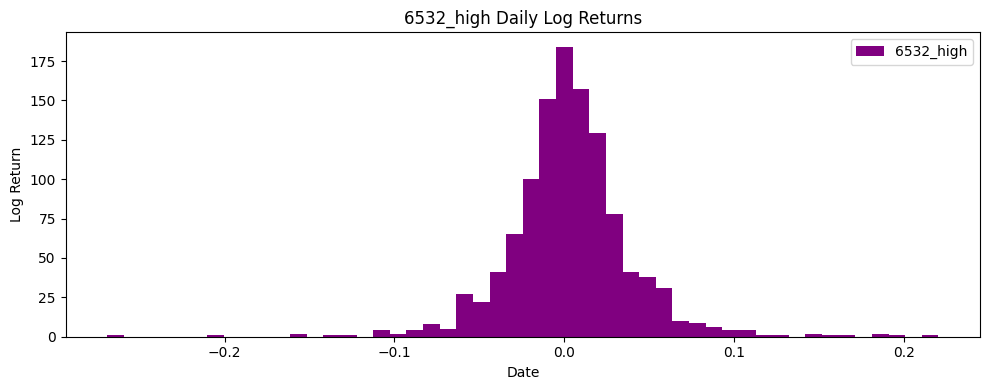

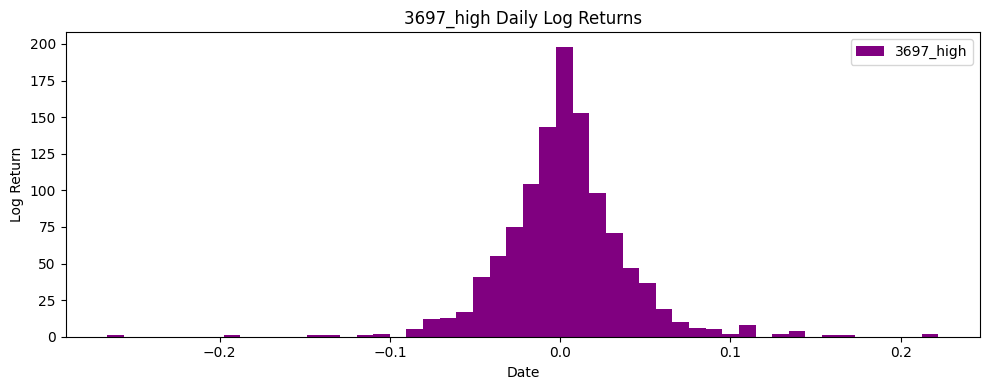

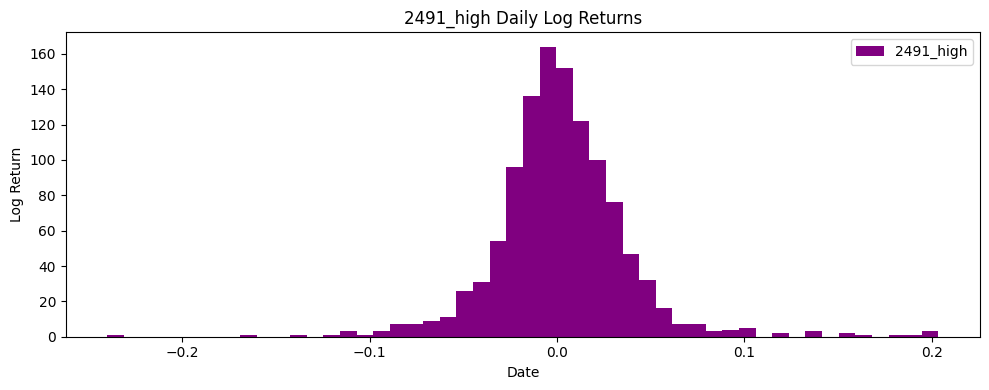

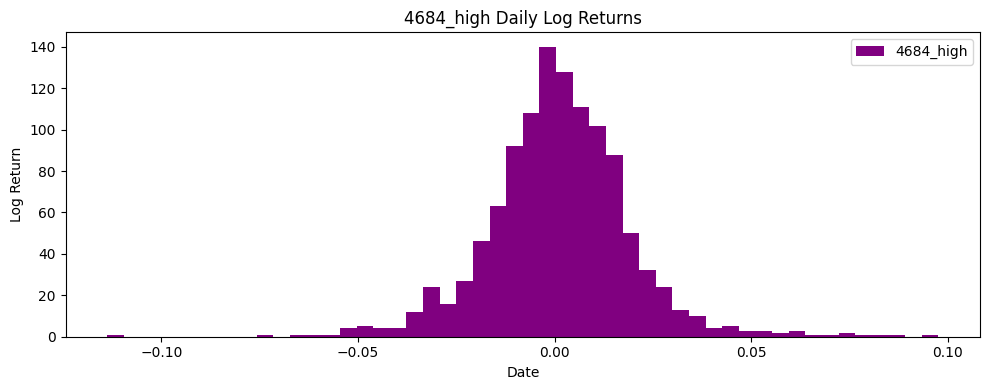

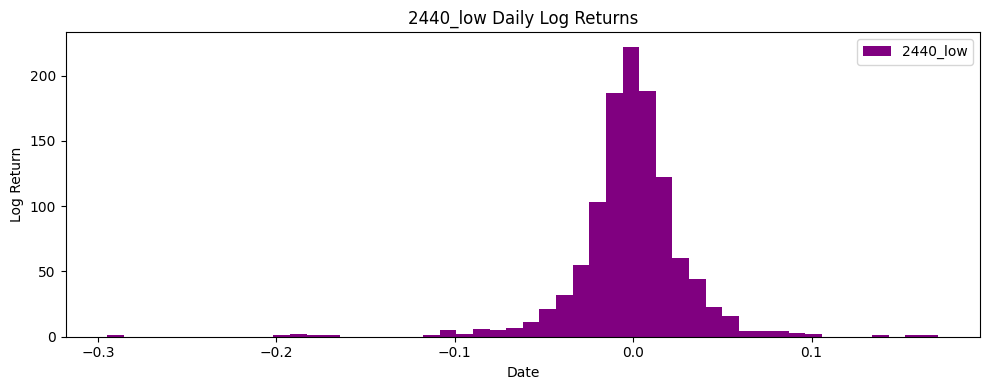

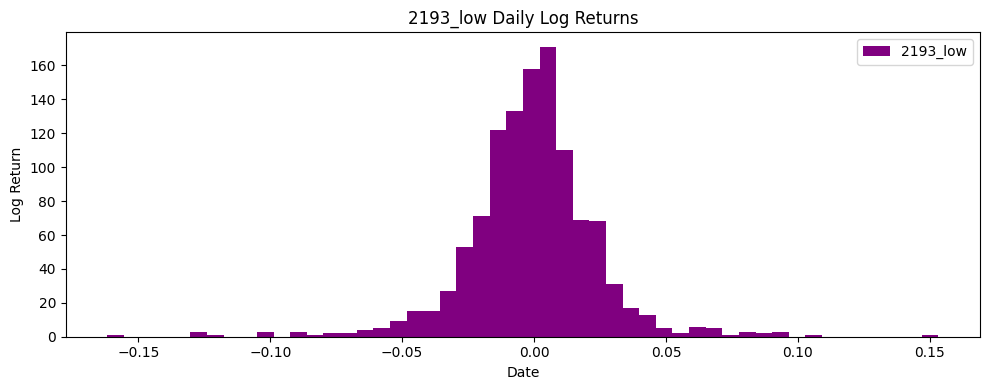

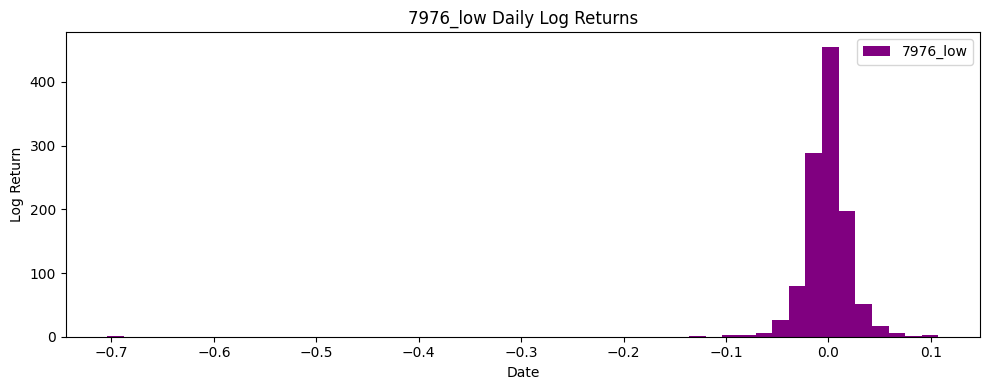

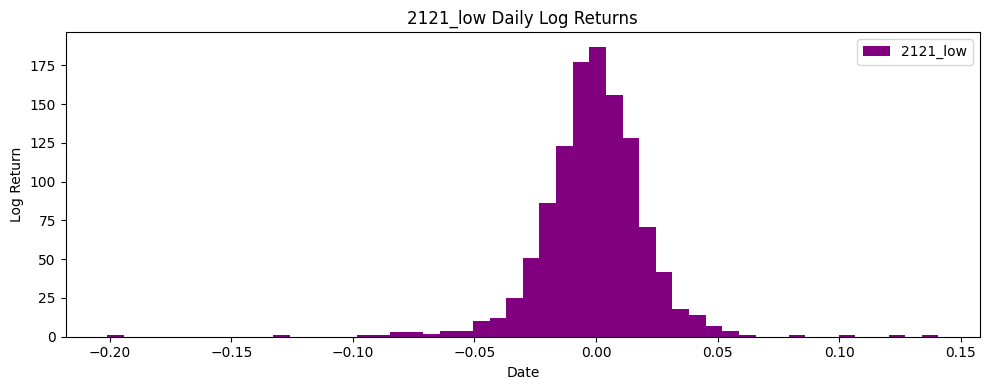

In [ ]:

for col in selected_stocks.columns:
  plt.figure(figsize=(10, 4))
  plt.hist(selected_stocks[col], label=col, color='purple', bins = 50)
  plt.title(f'{col} Daily Log Returns')
  plt.xlabel('Date')
  plt.ylabel('Log Return')
  plt.legend()
  plt.tight_layout()
  plt.show()

In [ ]:
#Analyzing goodness of fit for selected stocks

for col in selected_stocks.columns:

  data = selected_stocks[col]  # replace with your column name

  # Fit different distributions
  distributions = ['norm', 't', 'laplace', 'logistic','gamma']
  results = {}

  for dist_name in distributions:
      dist = getattr(stats, dist_name)
      params = dist.fit(data)
      log_likelihood = dist.logpdf(data, *params).sum()
      results[dist_name] = {'params': params, 'loglik': log_likelihood}

  # Sort by best log-likelihood
  sorted_results = sorted(results.items(), key=lambda x: x[1]['loglik'], reverse=True)
  print(f"Best-fitting distributions for {col}(by log-likelihood):")
  for name, res in sorted_results:
      print(f"{name}: log-lik = {res['loglik']:.2f}")

Best-fitting distributions for 6532_high(by log-likelihood):
t: log-lik = 2259.32
laplace: log-lik = 2251.37
logistic: log-lik = 2227.66
norm: log-lik = 2125.79
gamma: log-lik = 2124.85
Best-fitting distributions for 3697_high(by log-likelihood):
t: log-lik = 2248.32
laplace: log-lik = 2246.91
logistic: log-lik = 2225.18
norm: log-lik = 2137.09
gamma: log-lik = 2135.66
Best-fitting distributions for 2491_high(by log-likelihood):
t: log-lik = 2309.54
laplace: log-lik = 2292.85
logistic: log-lik = 2276.26
norm: log-lik = 2169.82
gamma: log-lik = 2163.80
Best-fitting distributions for 4684_high(by log-likelihood):
t: log-lik = 2987.75
laplace: log-lik = 2978.38
logistic: log-lik = 2976.80
norm: log-lik = 2916.91
gamma: log-lik = 2916.62
Best-fitting distributions for 2440_low(by log-likelihood):
t: log-lik = 2538.32
laplace: log-lik = 2517.67
logistic: log-lik = 2479.61
norm: log-lik = 2327.10
gamma: log-lik = 2284.63
Best-fitting distributions for 2193_low(by log-likelihood):
t: log-lik 

In [ ]:
fitted_dist = {}
for col in selected_stocks.columns:
  data = selected_stocks[col]
  params = dist.fit(data)
  fitted_dist[col] = params

fitted_dist.items()

dict_items([('6532_high', (np.float64(1559.3956218285953), np.float64(-1.4714376422468822), np.float64(0.0009456199149187529))), ('3697_high', (np.float64(469.061280794607), np.float64(-0.8004198015618067), np.float64(0.0017120113997453955))), ('2491_high', (np.float64(103.8315089324193), np.float64(-0.3744738339462811), np.float64(0.0036184314604831742))), ('4684_high', (np.float64(489.45905745058985), np.float64(-0.4110853773512979), np.float64(0.0008420372954587006))), ('2440_low', (np.float64(324.28513541305756), np.float64(-0.6010661612812824), np.float64(0.0018466595233791365))), ('2193_low', (np.float64(0.38744121380834273), np.float64(-0.16173492318556626), np.float64(2.0012330271087335))), ('7976_low', (np.float64(0.3574442170357439), np.float64(-0.7041104853572149), np.float64(6.712656703781297))), ('2121_low', (np.float64(109.29099279404696), np.float64(-0.26236831607388567), np.float64(0.002407515398475788)))])

### Periodicity analysis - FFT transform

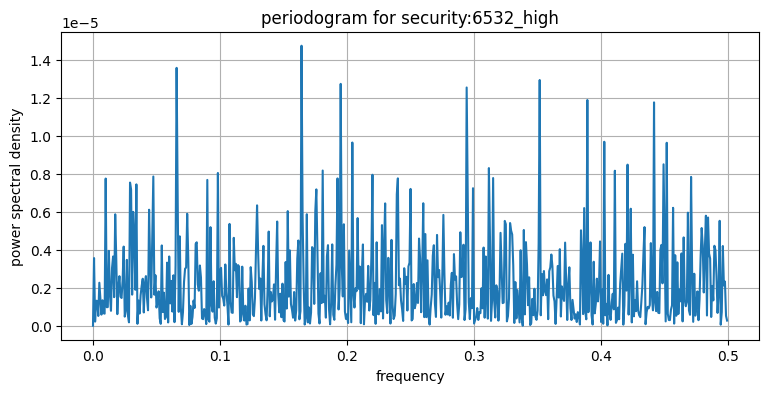

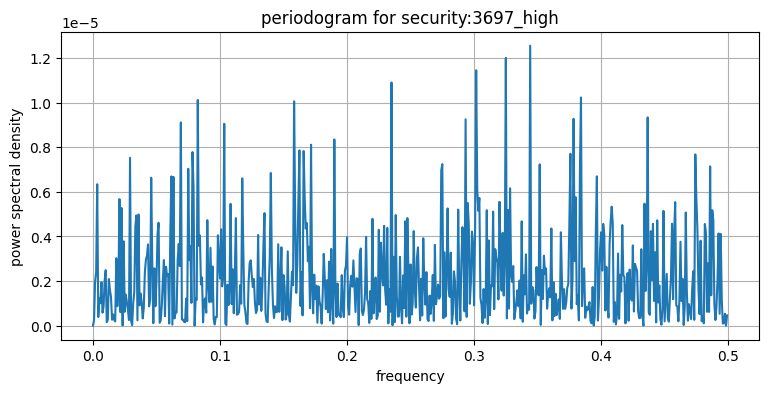

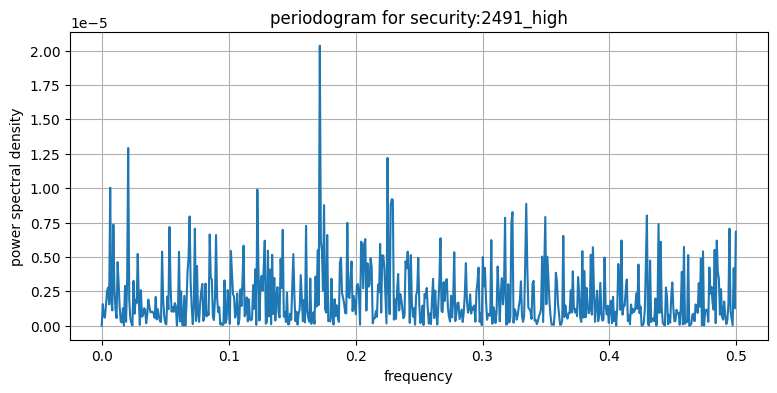

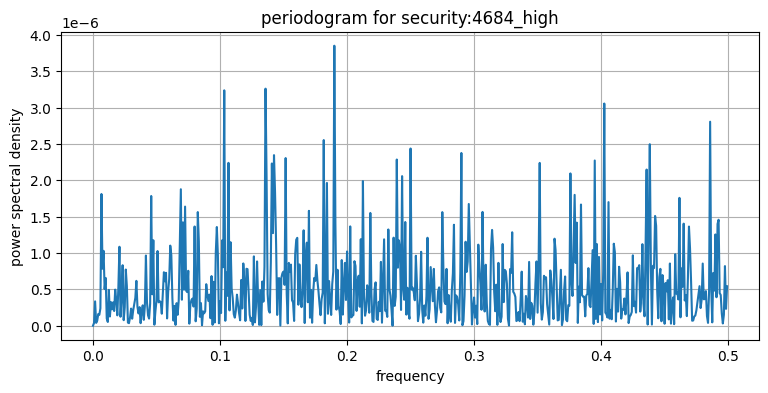

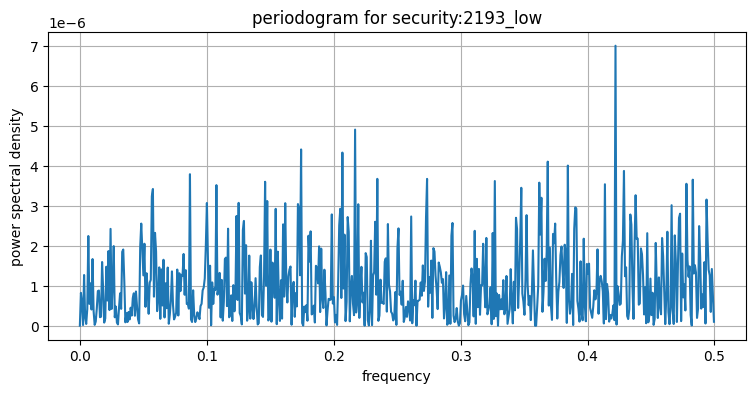

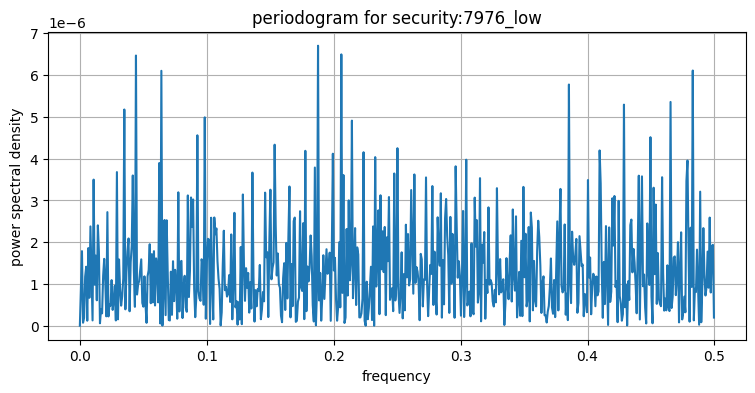

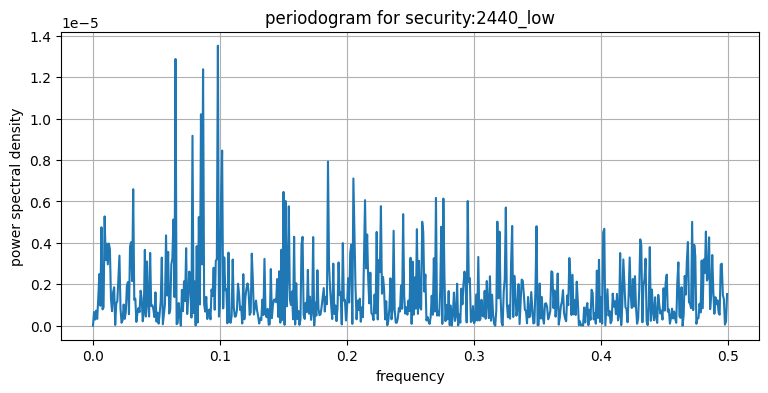

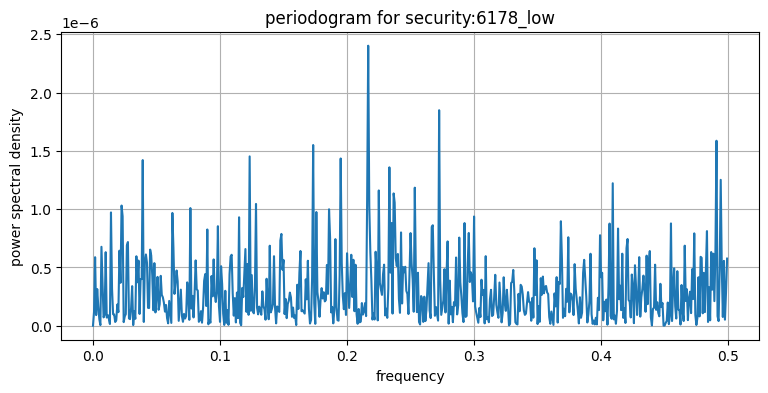

In [ ]:
def fit_visualize_periodogram(name, log_returns):
  f, Pxx_spec = signal.periodogram(log_returns, fs=1, scaling='spectrum')

  plt.figure(figsize=(9, 4))
  plt.plot(f, Pxx_spec)
  plt.title(f'periodogram for security:{name}')
  plt.xlabel('frequency')
  plt.ylabel('power spectral density')
  plt.grid(True)
  plt.show()

  return f, Pxx_spec

for col in selected_stocks.columns:
  f, Pxx_spec = fit_visualize_periodogram(col, selected_stocks[col])


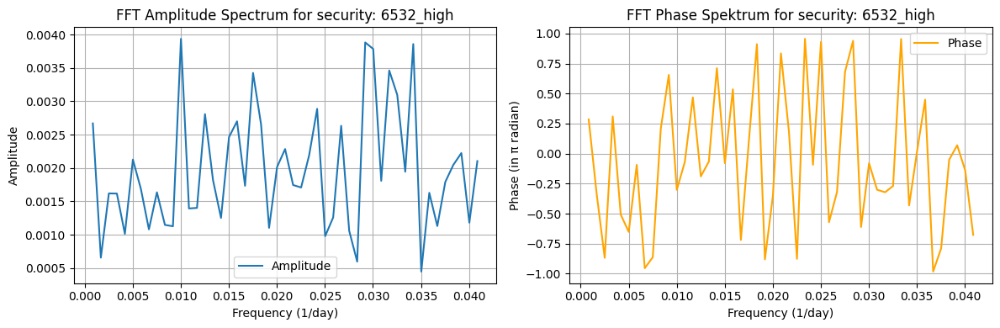

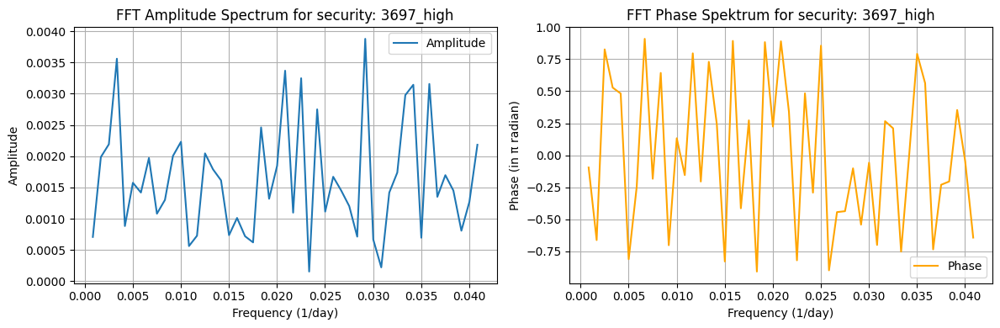

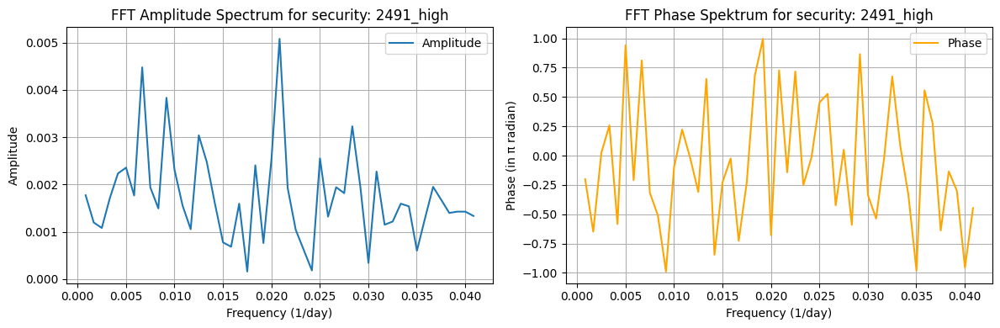

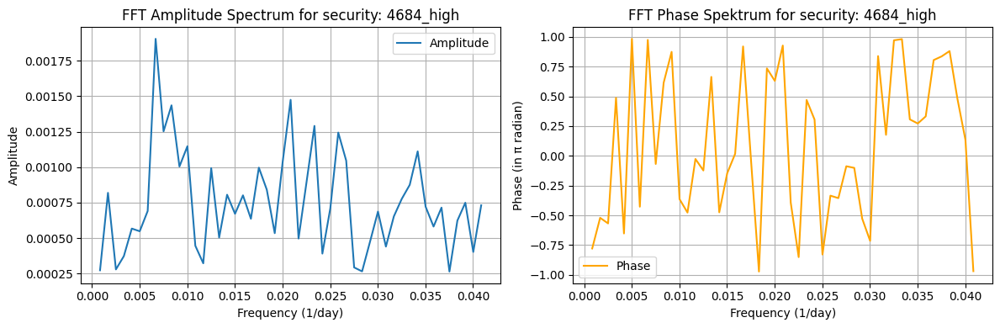

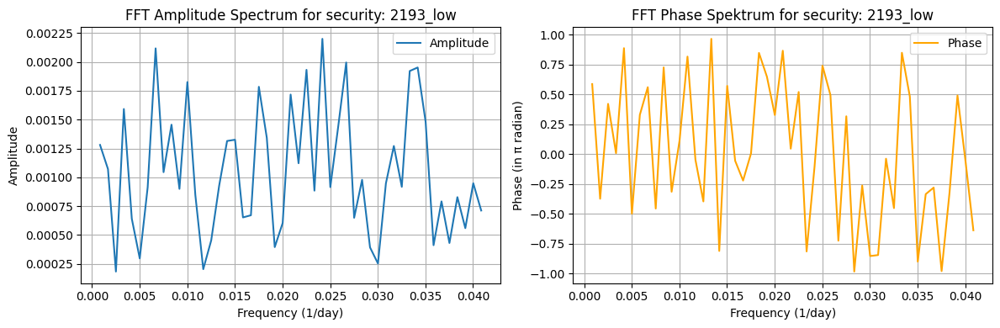

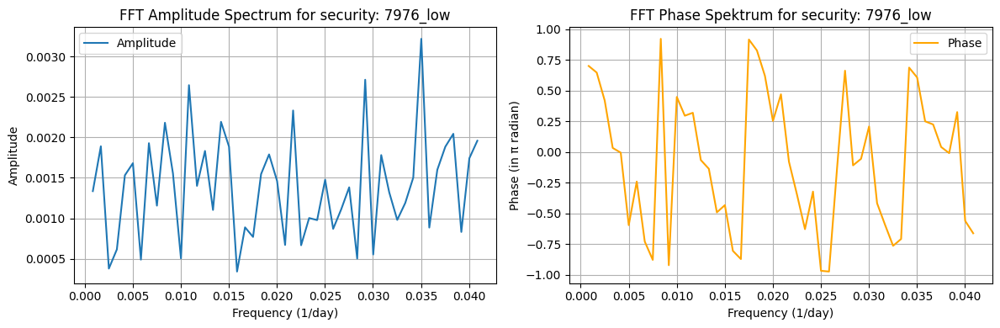

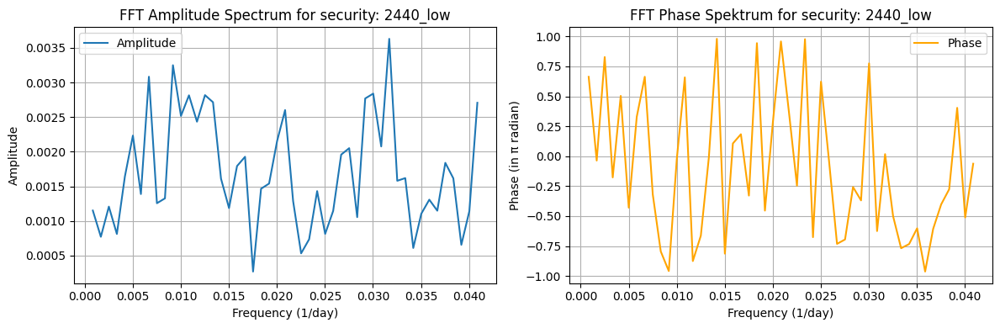

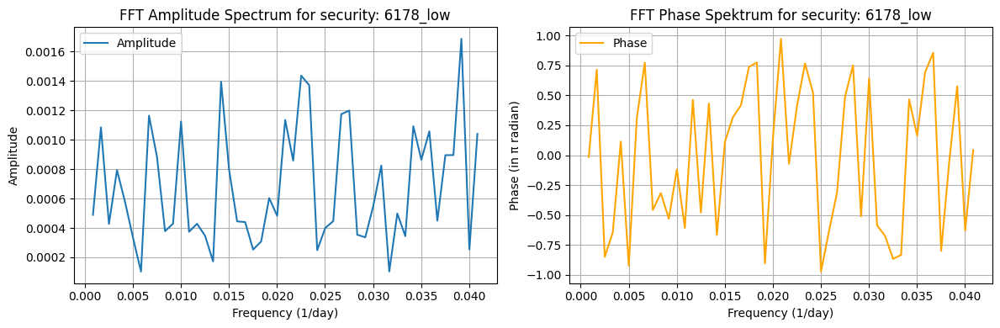

In [ ]:
def plot_phase_amplitude(name, log_returns):
  acfasn = sm.tsa.acf(log_returns, nlags=len(log_returns)//2, fft=True)

  Y      = np.fft.fft(log_returns)
  freq   = np.fft.fftfreq(len(log_returns), d=1)
  amplit = np.abs(Y) / (len(log_returns) / 2)  # amplitúdó skálázás
  phase  = np.angle(Y)
  phase  = phase / np.pi  # fázist pi radiánban fejezzük ki

  # Ábrázolás (csak a kis frekvenciás tartományra)
  fig, ax = plt.subplots(1, 2, figsize=(12, 4))
  ax[0].plot(freq[1:50], amplit[1:50], label='Amplitude')
  ax[1].plot(freq[1:50], phase[1:50], label='Phase', color='orange')
  ax[0].set_title(f'FFT Amplitude Spectrum for security: {name}')
  ax[1].set_title(f'FFT Phase Spektrum for security: {name}')
  ax[0].set_xlabel('Frequency (1/day)')
  ax[1].set_xlabel('Frequency (1/day)')
  ax[0].set_ylabel('Amplitude')
  ax[1].set_ylabel('Phase (in π radian)')
  ax[0].grid(True)
  ax[1].grid(True)
  ax[0].legend()
  ax[1].legend()
  plt.tight_layout()
  plt.show()

  return freq, amplit, phase

spectr_list = []
for col in selected_stocks.columns:
  freq, amplit, phase = plot_phase_amplitude(col, selected_stocks[col])
  spectr_list.append((freq, amplit, phase))

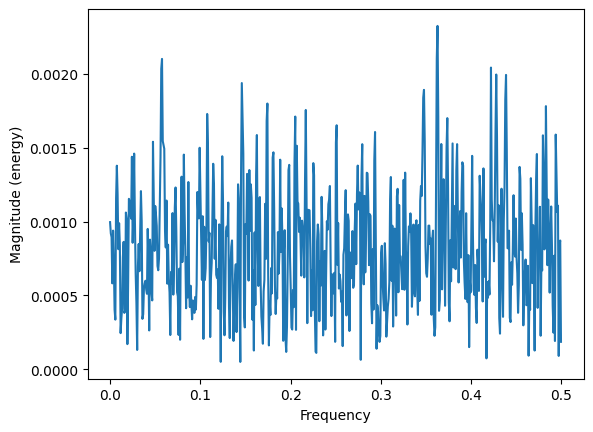

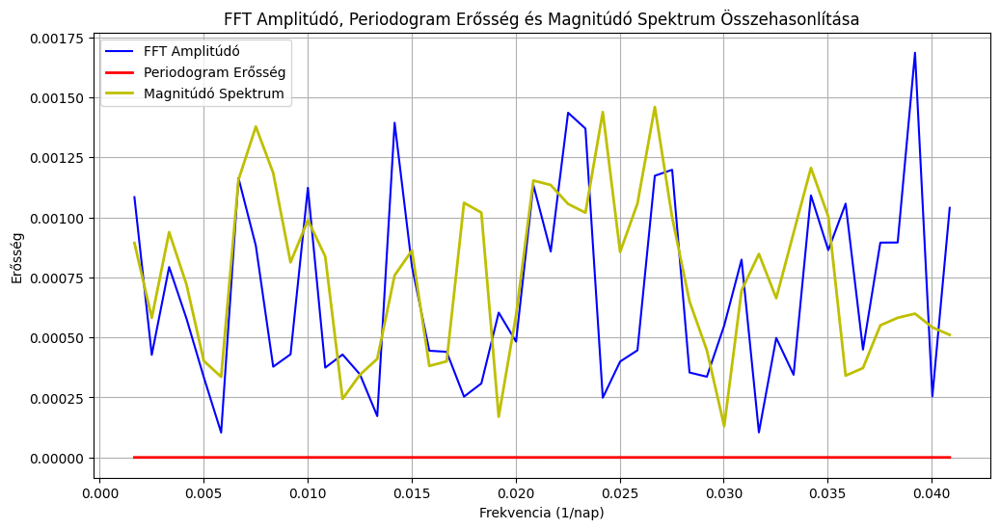

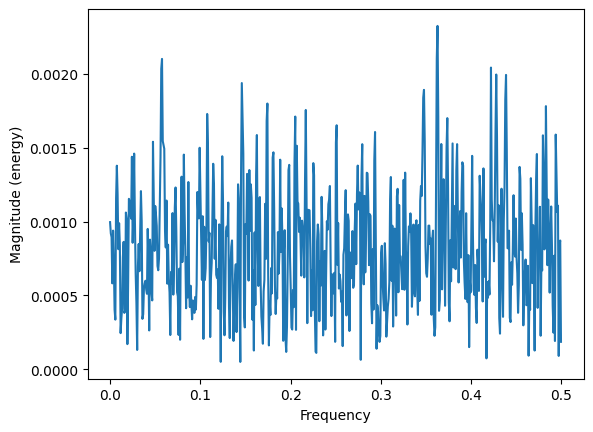

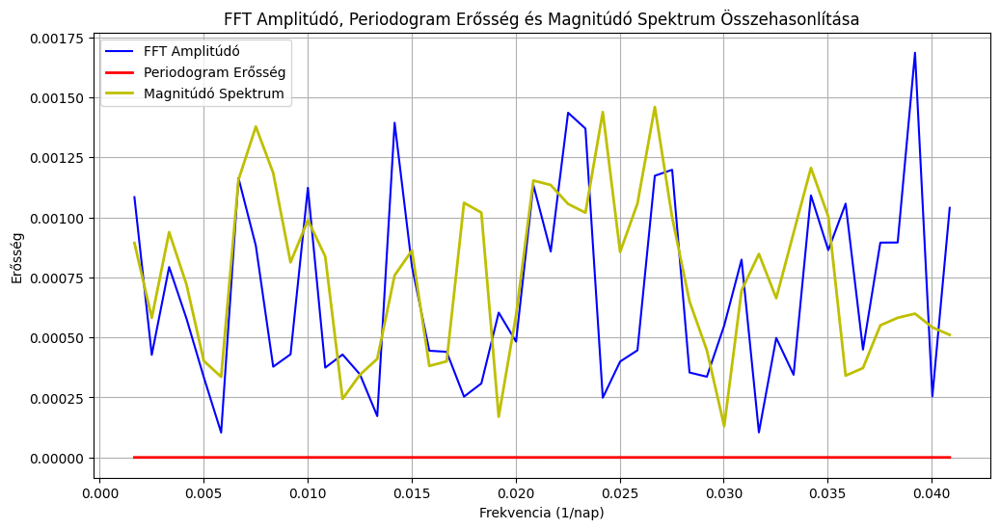

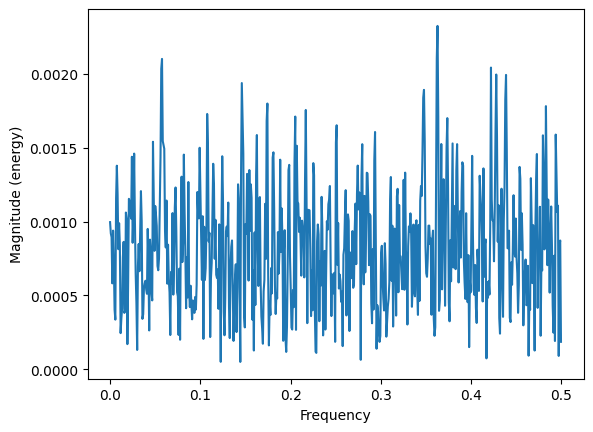

...

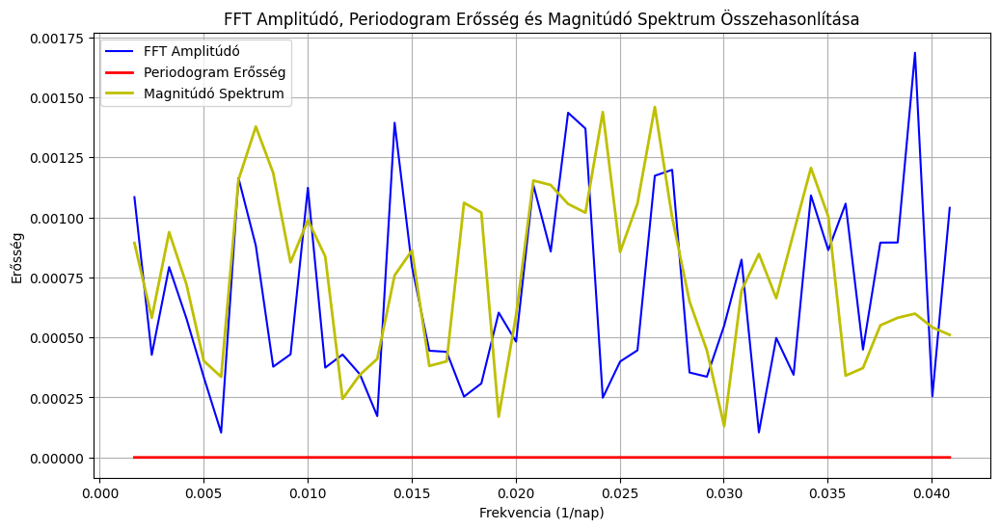

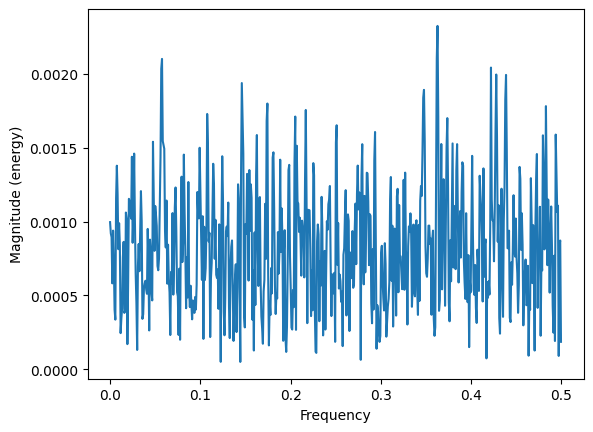

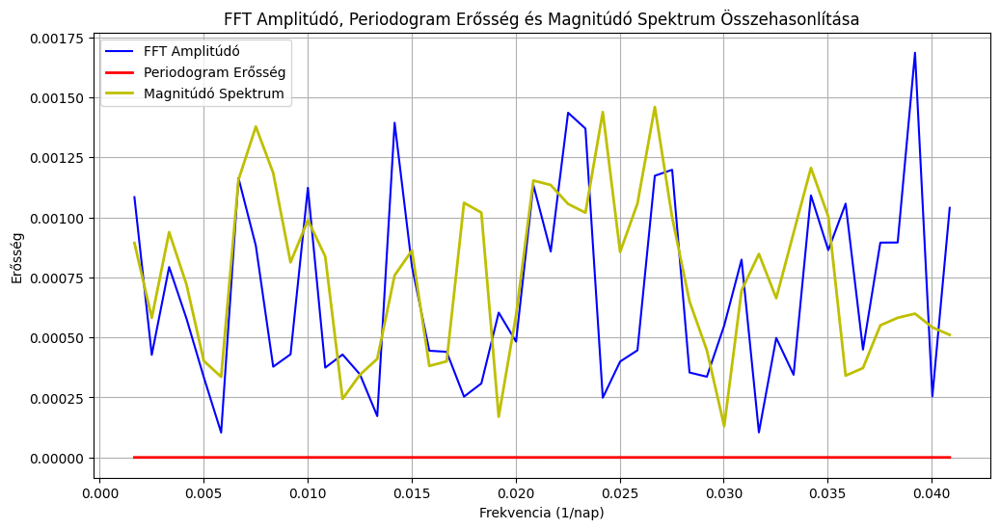

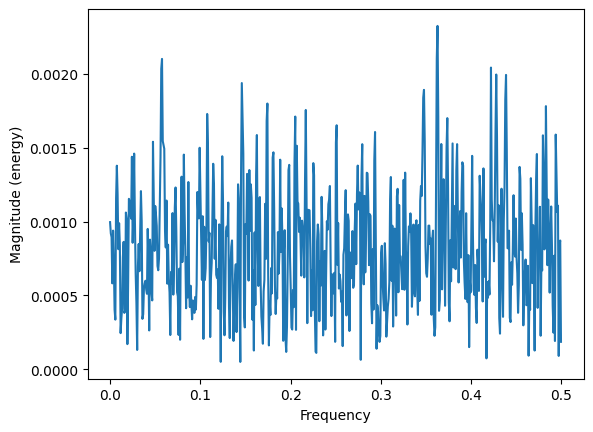

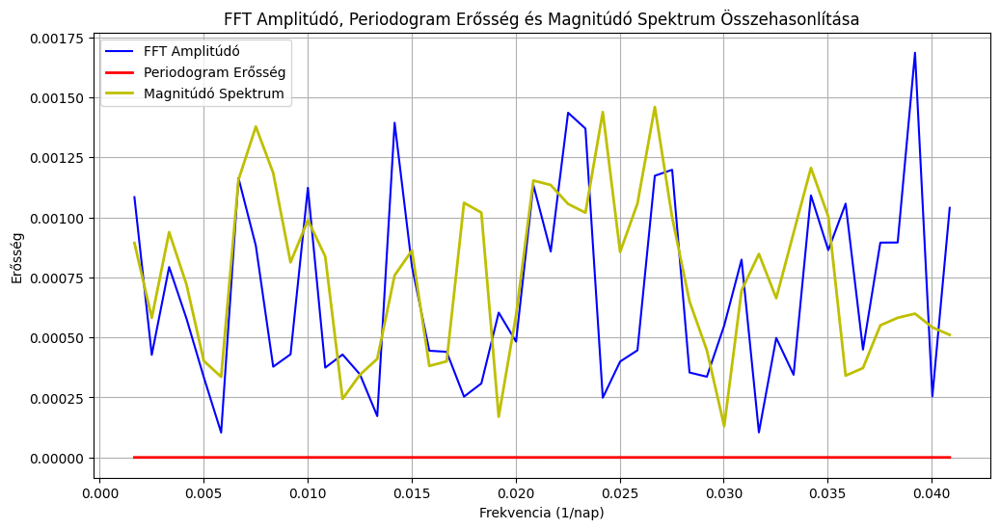

In [ ]:
for item in spectr_list:
  specsn = plt.magnitude_spectrum(log_returns[2193], Fs=1, window=None)

  plt.figure(figsize=(12, 6))
  plt.plot(freq[2:50], amplit[2:50], 'b', label='FFT Amplitúdó')
  plt.plot(freq[2:50], Pxx_spec[2:50]/58, 'r', label='Periodogram Erősség', linewidth=2)
  plt.plot(freq[2:50], specsn[0][2:50], 'y', label='Magnitúdó Spektrum', linewidth=2)
  plt.title('FFT Amplitúdó, Periodogram Erősség és Magnitúdó Spektrum Összehasonlítása')
  plt.xlabel('Frekvencia (1/nap)')
  plt.ylabel('Erősség')
  plt.grid(True)
  plt.legend()
  plt.show()

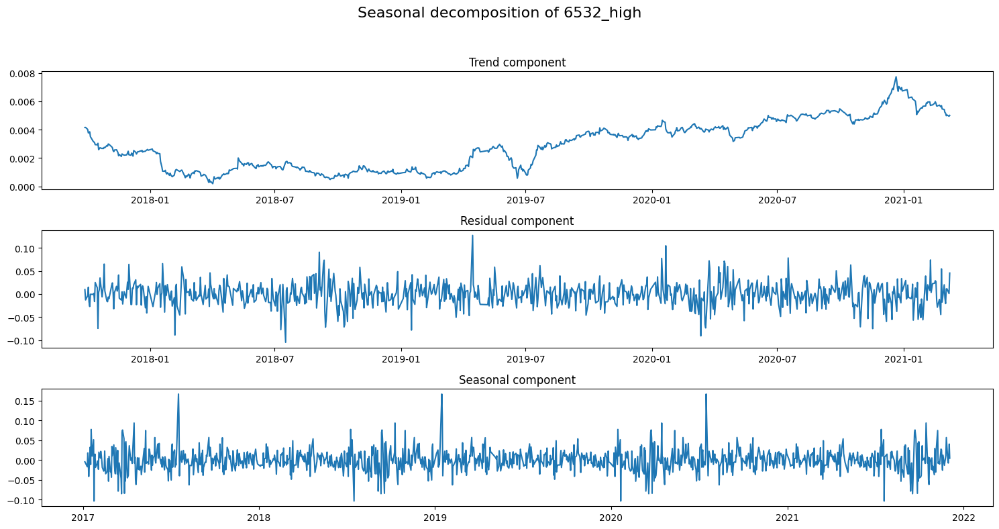

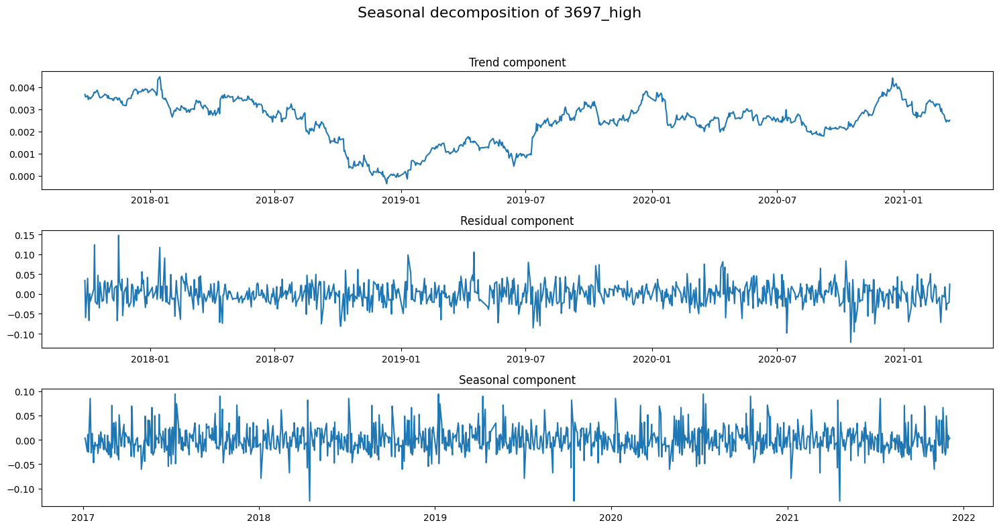

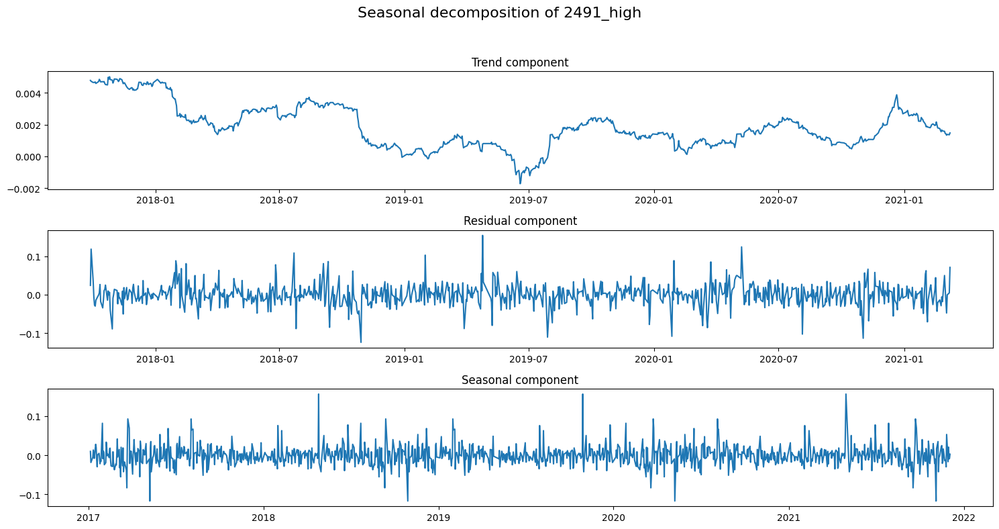

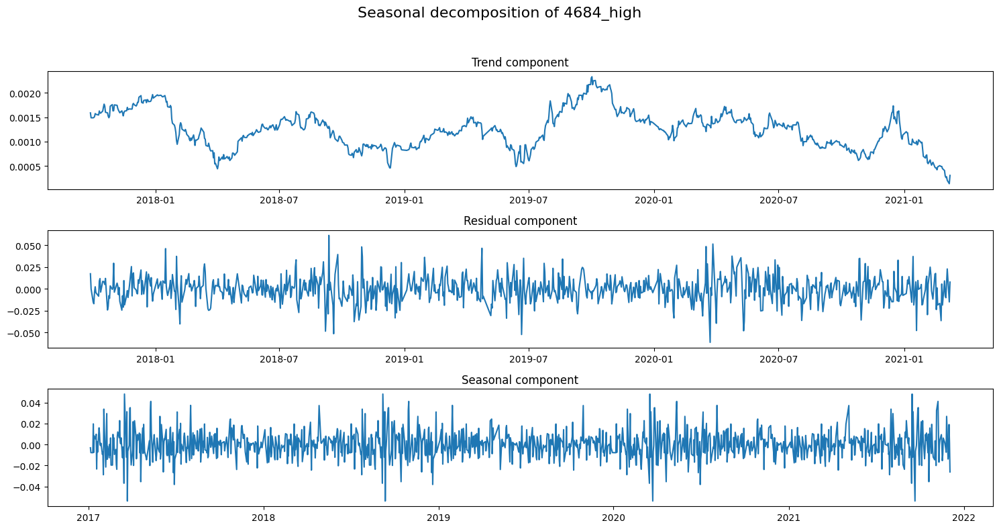

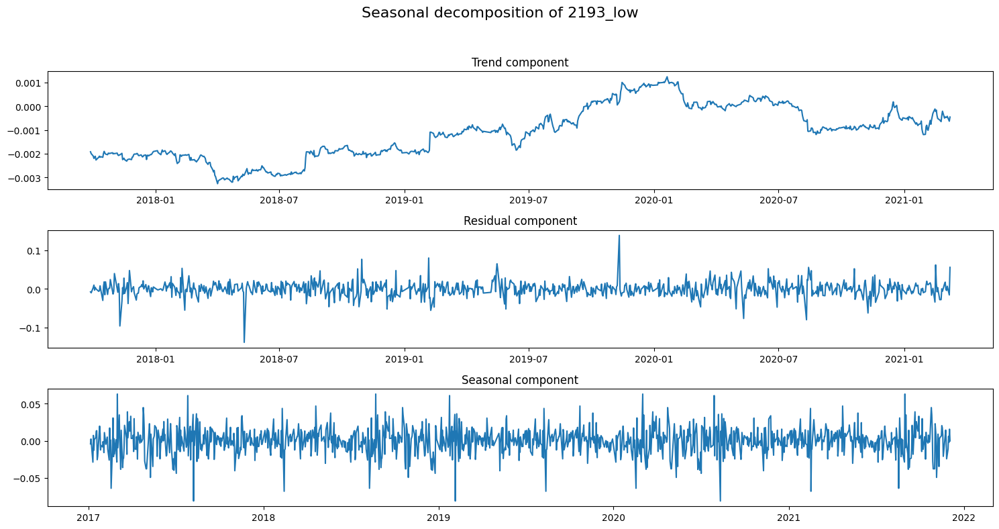

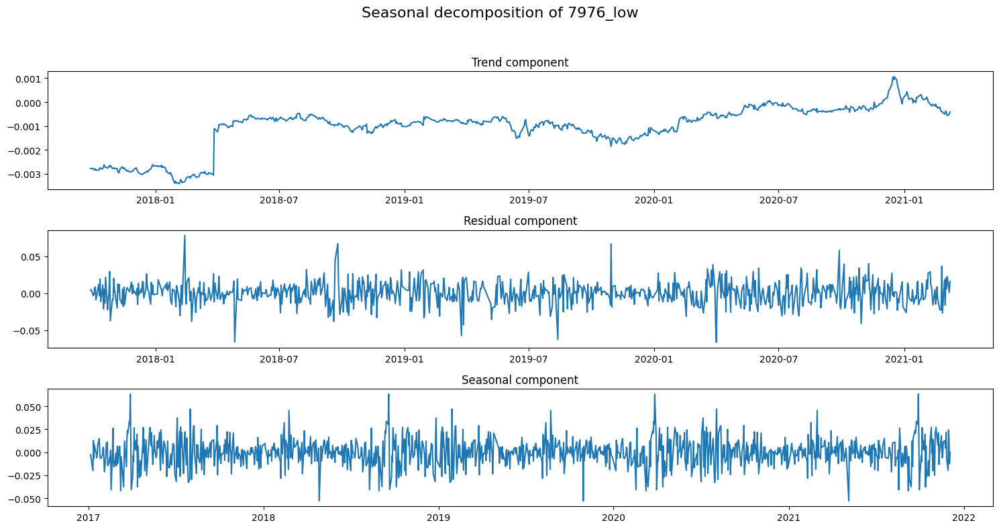

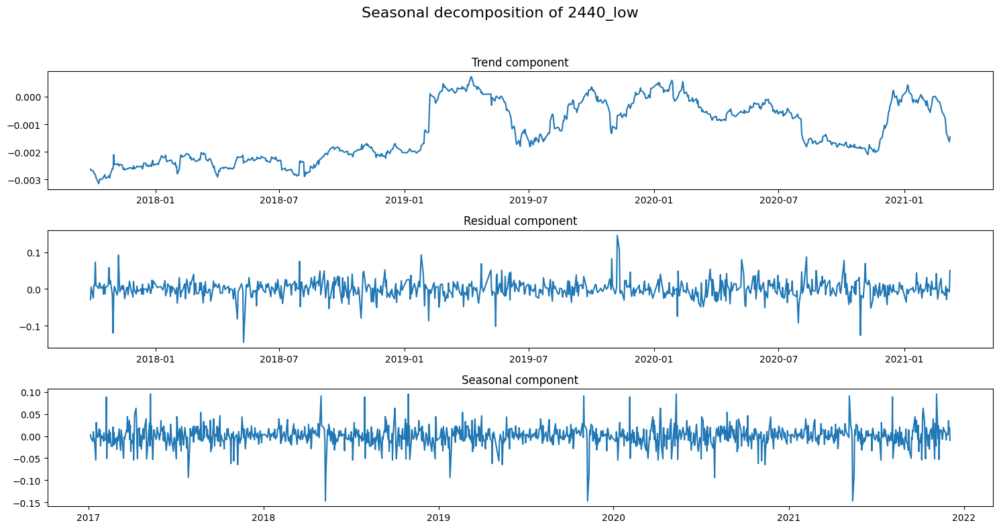

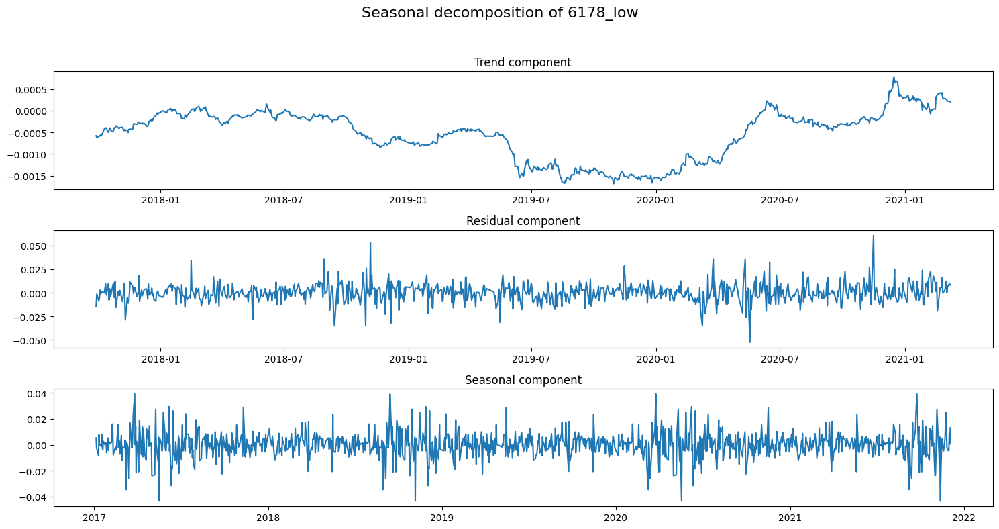

In [ ]:
def seasonal_decomp(log_returns, name):
    res = sm.tsa.seasonal_decompose(log_returns, period=365)
    residual = res.resid[np.isfinite(res.resid)]

    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(15, 8))
    fig.suptitle(f'Seasonal decomposition of {name}', fontsize=16)

    ax1.plot(res.trend)
    ax1.set_title("Trend component")

    ax2.plot(res.resid)
    ax2.set_title("Residual component")

    ax3.plot(res.seasonal)
    ax3.set_title("Seasonal component")

    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Reserve space for suptitle
    plt.show()

for col in selected_stocks.columns:
    seasonal_decomp(selected_stocks[col], col)

### Autocorrelation

/usr/local/lib/python3.11/dist-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


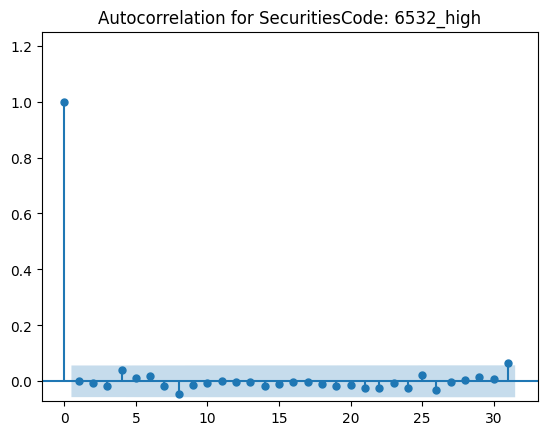

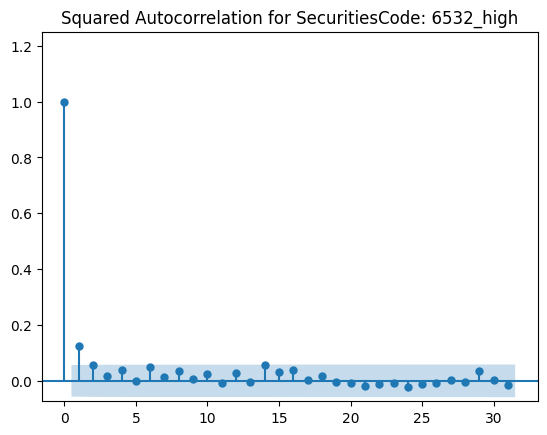

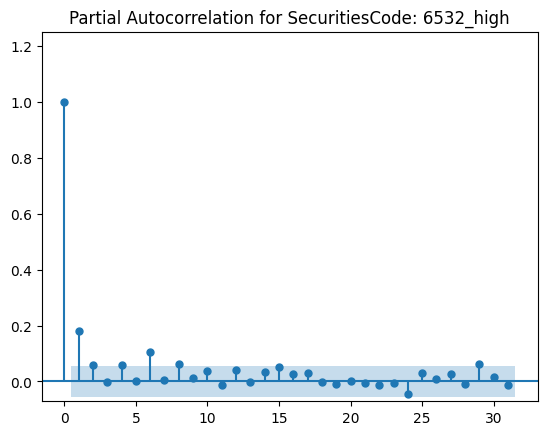

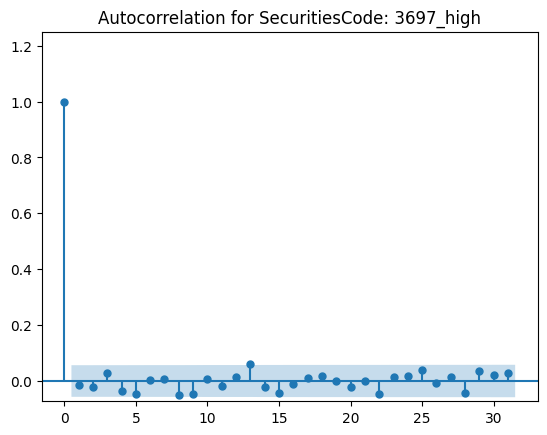

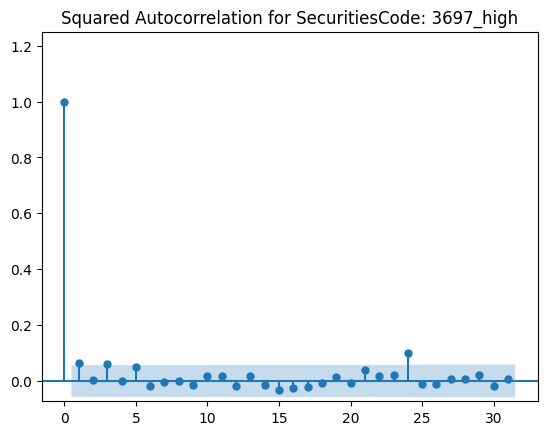

...

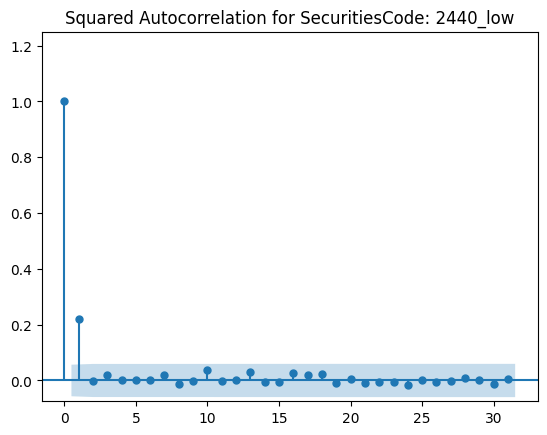

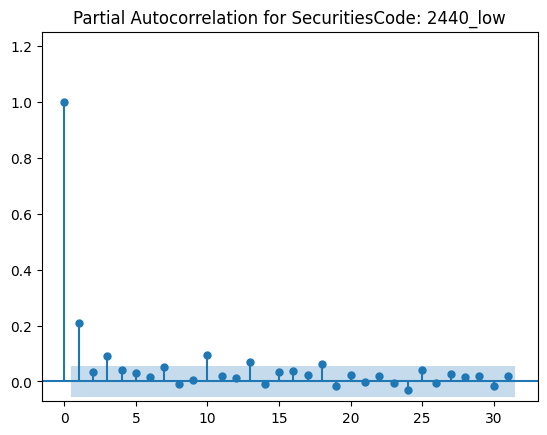

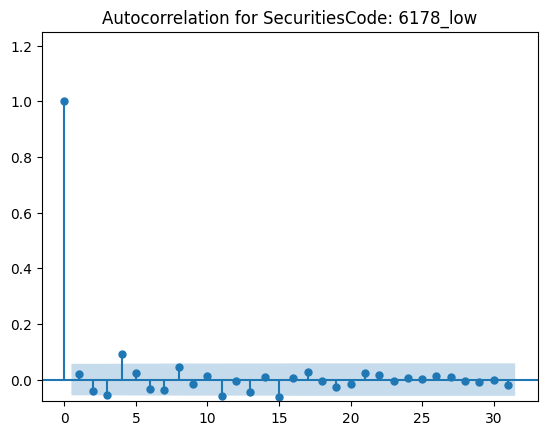

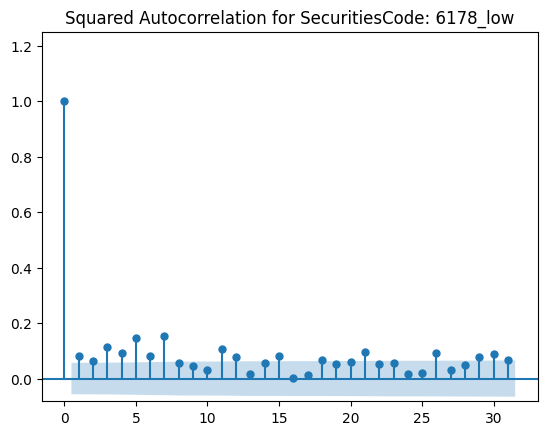

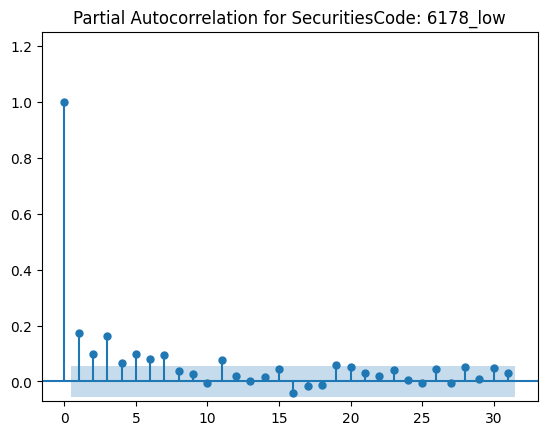

In [ ]:

#plot autocorrelations
for col in selected_stocks.columns:

    #plot autocorrelations
    plot_acf(selected_stocks[col], auto_ylims=True);
    plt.title(f'Autocorrelation for SecuritiesCode: {col}')
    plot_acf(np.power(selected_stocks[col], 2), auto_ylims=True,label ='asd');
    plt.title(f'Squared Autocorrelation for SecuritiesCode: {col}')
    plot_pacf(np.abs(selected_stocks[col]), auto_ylims=True);
    plt.title(f'Partial Autocorrelation for SecuritiesCode: {col}')

### Stationarity

In [ ]:
def print_adf(log_returns):
    should_diff = ADFTest().should_diff(log_returns)
    print(f"Should difference: {should_diff}")

    result = adfuller(log_returns, autolag='t-stat')
    print('ADF Statistic: %f' % result[0])
    print('p-value: %f' % result[1])
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))

for col in selected_stocks.columns:
    print_adf(selected_stocks[col])

/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Should difference: (0.01, False)
ADF Statistic: -34.577056
p-value: 0.000000
Critical Values:
	1%: -3.436
	5%: -2.864
	10%: -2.568
Should difference: (0.01, False)
ADF Statistic: -9.719471
p-value: 0.000000
Critical Values:
	1%: -3.436
	5%: -2.864
	10%: -2.568
Should difference: (0.01, False)
ADF Statistic: -7.101362
p-value: 0.000000
Critical Values:
	1%: -3.436
	5%: -2.864
	10%: -2.568
Should difference: (0.01, False)
ADF Statistic: -6.830962
p-value: 0.000000
Critical Values:
	1%: -3.436
	5%: -2.864
	10%: -2.568


/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/utils/deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/usr/local/lib/python3.11

Should difference: (0.01, False)
ADF Statistic: -7.636934
p-value: 0.000000
Critical Values:
	1%: -3.436
	5%: -2.864
	10%: -2.568
Should difference: (0.01, False)
ADF Statistic: -35.085500
p-value: 0.000000
Critical Values:
	1%: -3.436
	5%: -2.864
	10%: -2.568
Should difference: (0.01, False)
ADF Statistic: -7.167502
p-value: 0.000000
Critical Values:
	1%: -3.436
	5%: -2.864
	10%: -2.568
Should difference: (0.01, False)
ADF Statistic: -10.038240
p-value: 0.000000
Critical Values:
	1%: -3.436
	5%: -2.864
	10%: -2.568


In [ ]:
def print_kpss(log_returns):
    print ('Results of KPSS Test:')
    kpsstest = kpss(log_returns, regression='c', nlags="auto")
    kpss_output = pd.Series(kpsstest[0:3], index=['Test Statistic','p-value','Lags Used'])
    for key,value in kpsstest[3].items():
        kpss_output['Critical Value (%s)'%key] = value
    print (kpss_output)


for col in selected_stocks.columns:
    print(selected_stocks[col])
    print_kpss(selected_stocks[col])

Date
2017-01-05    0.003634
2017-01-06    0.034466
2017-01-10    0.050124
2017-01-11    0.006645
2017-01-12   -0.015573
                ...   
2021-11-29    0.005094
2021-11-30   -0.039383
2021-12-01    0.037349
2021-12-02   -0.007154
2021-12-03    0.016277
Name: 6532_high, Length: 1199, dtype: float64
Results of KPSS Test:
Test Statistic           0.100597
p-value                  0.100000
Lags Used                4.000000
Critical Value (10%)     0.347000
Critical Value (5%)      0.463000
Critical Value (2.5%)    0.574000
Critical Value (1%)      0.739000
dtype: float64
Date
2017-01-05    0.041608
2017-01-06   -0.003781
2017-01-10    0.014291
2017-01-11   -0.031098
2017-01-12    0.010728
                ...   
2021-11-29    0.000788
2021-11-30   -0.003155
2021-12-01   -0.000395
2021-12-02   -0.036616
2021-12-03    0.013434
Name: 3697_high, Length: 1199, dtype: float64
Results of KPSS Test:
Test Statistic           0.041032
p-value                  0.100000
Lags Used                4.

<ipython-input-23-b3b8a14bae47>:3: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpsstest = kpss(log_returns, regression='c', nlags="auto")
<ipython-input-23-b3b8a14bae47>:3: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpsstest = kpss(log_returns, regression='c', nlags="auto")
<ipython-input-23-b3b8a14bae47>:3: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpsstest = kpss(log_returns, regression='c', nlags="auto")
<ipython-input-23-b3b8a14bae47>:3: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpsstes

### Principal Component Analysis

In [ ]:
#flatten col indices and merge macro variables
temp_df = cleaned_data.copy()
#temp_df.drop(columns = ['log_return'], axis = 1, inplace = True)
temp_df.columns = ['_'.join(map(str, col)).strip() for col in temp_df.columns.to_flat_index()]
merged = pd.merge(temp_df, macro_data, left_index=True, right_index=True)

merged = (merged - merged.mean())/merged.std()

In [ ]:
stocks_df = (temp_df-temp_df.mean())/temp_df.std()
stocks_df

,High_1954,High_1973,High_2120,High_2121,High_2124,High_2127,High_2130,High_2146,High_2148,High_2150,...,log_return_9769,log_return_9783,log_return_9787,log_return_9788,log_return_9790,log_return_9793,log_return_9795,log_return_9889,log_return_9928,log_return_9984
Date,,,,,,,,,,,,,,,,,,,,,
2017-01-05,-0.936245,-0.579005,0.964667,0.839875,-1.324730,-0.578212,-1.315369,-2.182189,-0.703474,-0.605140,...,0.392263,0.462740,1.257303,0.118095,2.292179,0.046019,1.566292,1.061909,1.641261,0.608591
2017-01-06,-0.943621,-0.498564,1.128461,0.822103,-1.305589,-0.513443,-1.242971,-2.185802,-0.616885,-0.604642,...,-0.351590,0.282556,0.350368,0.117861,-0.380989,-0.529928,-0.268750,0.364030,-0.362225,0.788039
2017-01-10,-0.982959,-0.512928,1.119102,0.843429,-1.298411,-0.490583,-1.277921,-2.197846,-0.611387,-0.600653,...,-0.001604,-0.161036,-0.094550,0.117628,2.052529,-2.753579,-0.422329,0.639325,-0.125046,0.228344
2017-01-11,-1.012463,-0.560331,1.034865,0.868309,-1.367798,-0.524873,-1.227992,-2.178576,-0.641625,-0.584198,...,0.348382,0.016321,0.171802,-0.172221,-0.965334,-1.064943,-0.015935,0.022939,-0.824116,0.270066
2017-01-12,-1.204238,-0.579005,0.941268,0.864755,-1.401295,-0.536303,-1.266687,-2.213502,-0.652620,-0.585195,...,0.216188,0.105066,-1.804766,-0.114531,1.006280,-0.789640,-0.784277,-0.986303,-0.756172,-0.225653
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-29,0.802024,-1.061651,-1.674751,-0.821406,0.345350,-0.482963,0.860313,1.753580,1.294946,-0.417660,...,-1.326534,-1.093205,-1.089173,-0.183575,-1.122211,-0.861164,-2.702538,-2.356041,-2.358904,-0.615303
2021-11-30,0.617625,-1.050159,-1.656032,-0.825671,0.177863,-0.463914,0.921477,1.753580,1.333430,-0.428131,...,-0.225066,-0.224180,-1.108859,-0.246271,0.954269,0.982835,0.625451,-0.389130,-0.774806,-0.881119
2021-12-01,0.482399,-1.132037,-1.702830,-0.896757,0.211361,-0.517253,0.988882,1.488627,1.228974,-0.467023,...,-0.091203,0.681966,0.250632,0.435016,0.685565,-0.121697,-0.737905,-0.160622,0.693267,-0.657727


In [ ]:


#fit PCA to the whole dataset
def fit_visualize_pca(df, components):

    # Initialize PCA
    num_cols = df.select_dtypes(include=['int64', 'float64']).columns
    features_reduced = df[num_cols]

    pca = PCA(n_components=components)  # Keeping all components to analyze explained variance

    # Fit PCA on the scaled data
    pca.fit(features_reduced)

    # Transform the data using PCA
    features_pca = pca.transform(features_reduced)

    # Explained variance by each component
    explained_variance = pca.explained_variance_ratio_

    # Cumulative explained variance
    cumulative_variance = np.cumsum(explained_variance)


    # Plot explained variance and cumulative explained variance
    plt.figure(figsize=(12, 6))

    # Individual explained variance
    plt.subplot(1, 2, 1)
    plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.5, align='center', label='Individual Explained Variance')
    plt.ylabel('Explained Variance Ratio')
    plt.xlabel('Principal Component')
    plt.title('Explained Variance per Principal Component')

    # Cumulative explained variance
    plt.subplot(1, 2, 2)
    plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', linestyle='--', color='b')
    plt.ylabel('Cumulative Explained Variance')
    plt.xlabel('Principal Components')
    plt.title('Cumulative Explained Variance')
    plt.axhline(y=0.90, color='r', linestyle='--', label='90% threshold')
    plt.legend()

    plt.tight_layout()
    plt.show()

    idx = np.argmax(cumulative_variance >= 0.9)
    value = cumulative_variance[idx] if cumulative_variance[idx] >= 0.9 else None  # in case no match

    print("Number of PCs to explain 90% variance:", idx)

    loadings = pca.components_.T

    selected_loadings = loadings[[1,2]]
    loadings_df = pd.DataFrame(loadings, columns=[f'PC{i+1}' for i in range(loadings.shape[1])], index=features_reduced.columns).head(10)
    selected_PC = ['PC1', 'PC2']
    print('Top 10 loadings for first 2 PCs:')
    print(loadings_df[selected_PC].sort_values(by = 'PC1',key = abs, ascending = False))
    return loadings, features_reduced



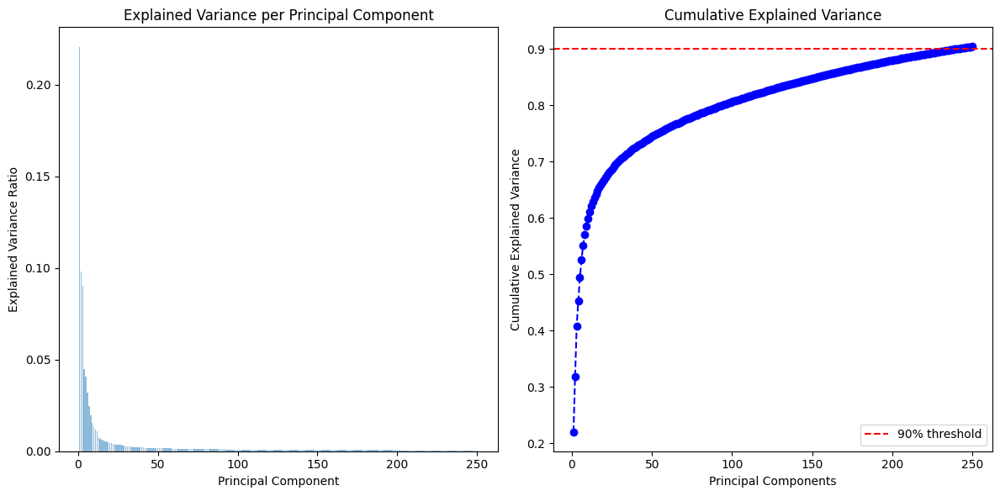

Number of PCs to explain 90% variance: 239
Top 10 loadings for first 2 PCs:
                PC1       PC2
High_2120 -0.044216  0.007587
High_2130  0.040120  0.023926
High_2148  0.039168  0.020975
High_2121 -0.034983  0.009427
High_2150  0.028084  0.026541
High_2124 -0.016388  0.031566
High_2146  0.013953  0.057057
High_1973 -0.008400 -0.023905
High_1954 -0.005268  0.036182
High_2127  0.001733  0.017883


In [ ]:
loadings, features_reduced = fit_visualize_pca(stocks_df, 250)

In [ ]:
# List loadings for the first 2 PCs for each country

selected_loadings = loadings[[1,2]]
loadings_df = pd.DataFrame(loadings, columns=[f'PC{i+1}' for i in range(loadings.shape[1])], index=features_reduced.columns).head(10)
selected_PC = ['PC1', 'PC2']
print(loadings_df[selected_PC].sort_values(by = 'PC1',key = abs, ascending = False))

                PC1       PC2
High_2120 -0.044216  0.007587
High_2130  0.040120  0.023926
High_2148  0.039168  0.020975
High_2121 -0.034983  0.009427
High_2150  0.028084  0.026541
High_2124 -0.016388  0.031566
High_2146  0.013953  0.057057
High_1973 -0.008400 -0.023905
High_1954 -0.005268  0.036182
High_2127  0.001733  0.017883


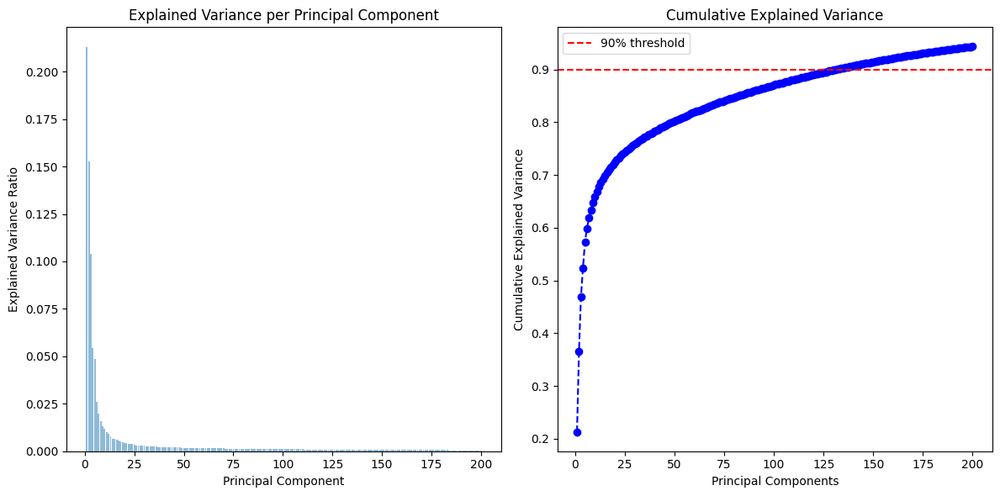

Number of PCs to explain 90% variance: 131
Top 10 loadings for first 2 PCs:
                PC1       PC2
High_2120  0.043694  0.020079
High_2121  0.039716 -0.001310
High_2130 -0.037398  0.014551
High_2148 -0.024777  0.008378
High_2150 -0.022885  0.011505
High_2146 -0.015116  0.059333
High_1973 -0.014758 -0.007483
High_2124  0.013083  0.037102
High_2127  0.002428  0.029555
High_1954 -0.000739  0.024612


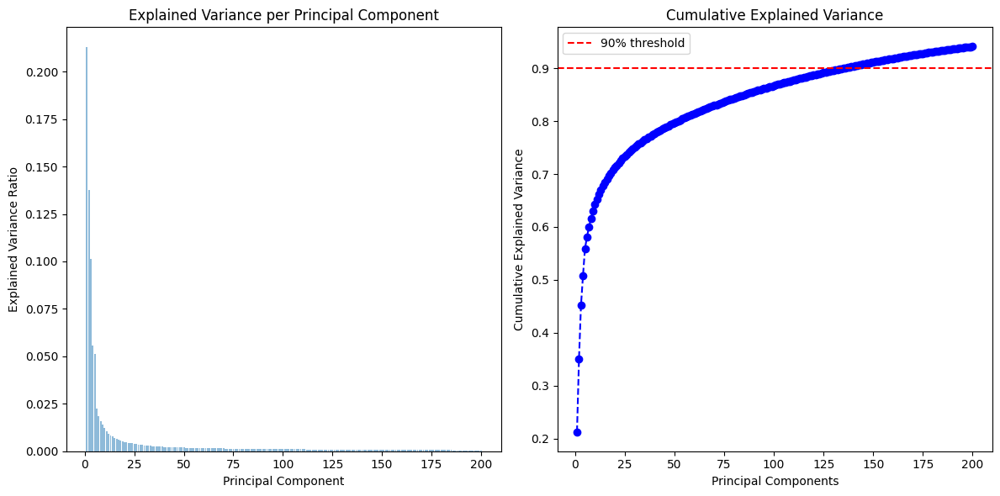

Number of PCs to explain 90% variance: 135
Top 10 loadings for first 2 PCs:
                PC1       PC2
High_2120  0.043375  0.015242
High_2121  0.042370 -0.009295
High_2130 -0.036100  0.022063
High_2150 -0.025310  0.019955
High_2148 -0.024302  0.010616
High_2124  0.018496  0.037008
High_1973 -0.010267 -0.019573
High_2146 -0.008647  0.062934
High_2127  0.006642  0.016162
High_1954 -0.000477  0.014350


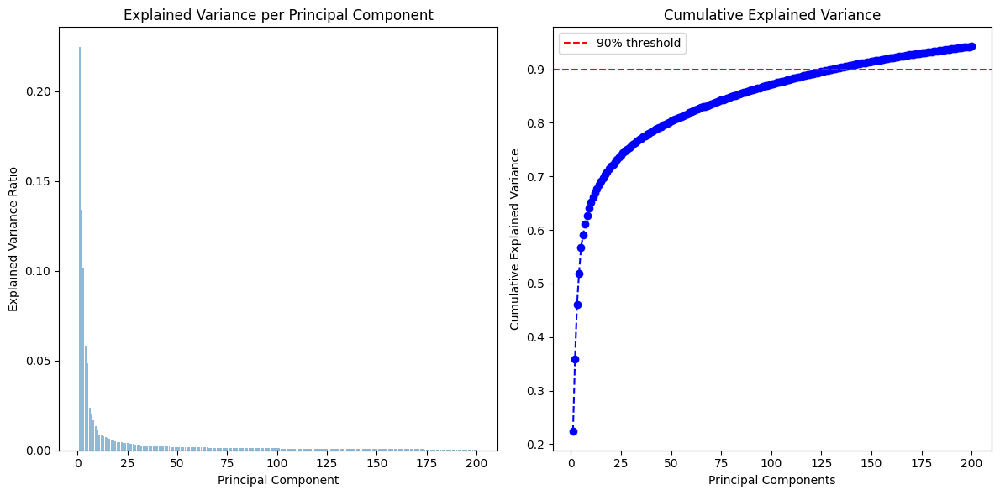

Number of PCs to explain 90% variance: 130
Top 10 loadings for first 2 PCs:
                PC1       PC2
High_2120  0.044259  0.004814
High_2121  0.041508 -0.016076
High_2130 -0.033369  0.032240
High_2148 -0.025495  0.014058
High_2150 -0.025458  0.030518
High_2124  0.025124  0.036128
High_2127  0.006119  0.000494
High_1973 -0.005681 -0.027918
High_1954  0.002916  0.009792
High_2146 -0.001708  0.064073


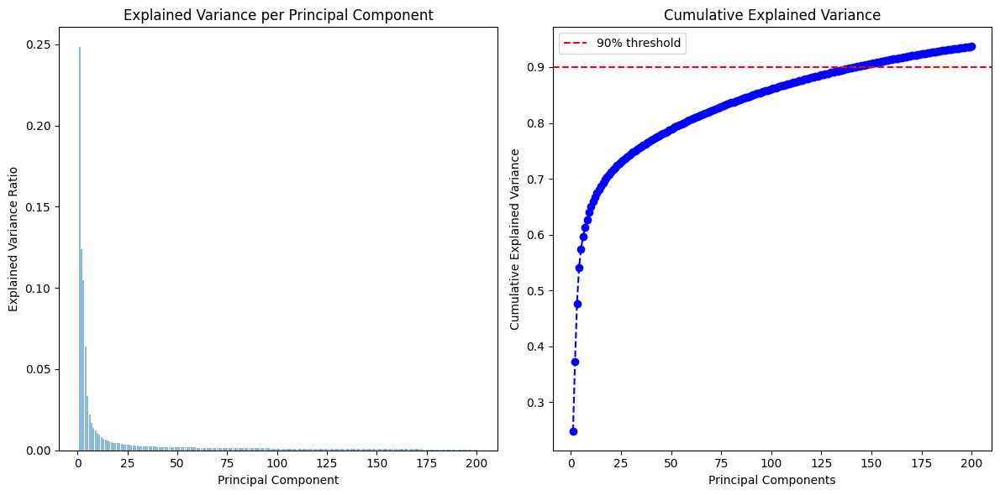

Number of PCs to explain 90% variance: 141
Top 10 loadings for first 2 PCs:
                PC1       PC2
High_2120  0.041490 -0.000359
High_2121  0.040190 -0.033773
High_2130 -0.035169  0.026303
High_2148 -0.031833  0.000408
High_2150 -0.028908  0.012011
High_2124  0.022698  0.043900
High_1954  0.003451 -0.000005
High_2127  0.003436 -0.020713
High_2146 -0.002841  0.060636
High_1973  0.001698 -0.012473


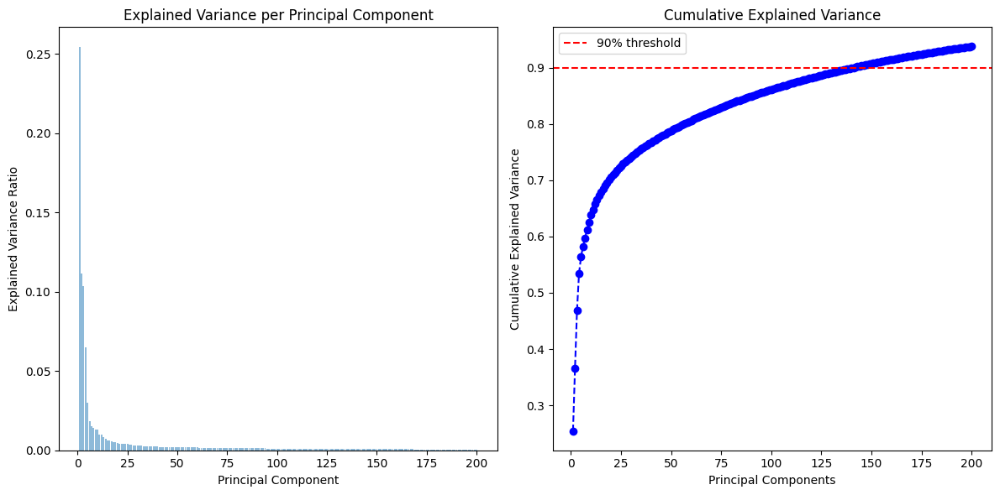

Number of PCs to explain 90% variance: 140
Top 10 loadings for first 2 PCs:
                PC1       PC2
High_2120  0.039192 -0.004760
High_2130 -0.038020  0.010573
High_2121  0.037797 -0.047368
High_2148 -0.037112 -0.017704
High_2150 -0.030854 -0.021366
High_2124  0.017974  0.049533
High_1973  0.009116  0.007876
High_2146 -0.006793  0.044611
High_1954  0.004151 -0.020144
High_2127  0.002352 -0.027475


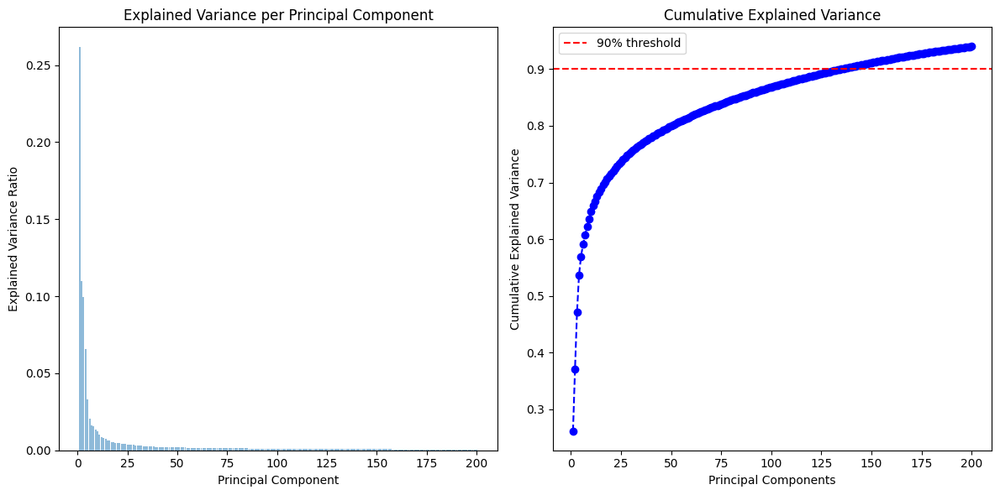

Number of PCs to explain 90% variance: 134
Top 10 loadings for first 2 PCs:
                PC1       PC2
High_2148 -0.042959  0.024022
High_2130 -0.039703  0.017738
High_2120  0.039106  0.002219
High_2121  0.032474  0.044172
High_2150 -0.029167  0.044344
High_2124  0.017525 -0.014317
High_1973  0.014909 -0.015768
High_2146 -0.009628 -0.006754
High_1954  0.007428  0.042467
High_2127 -0.000222  0.011003


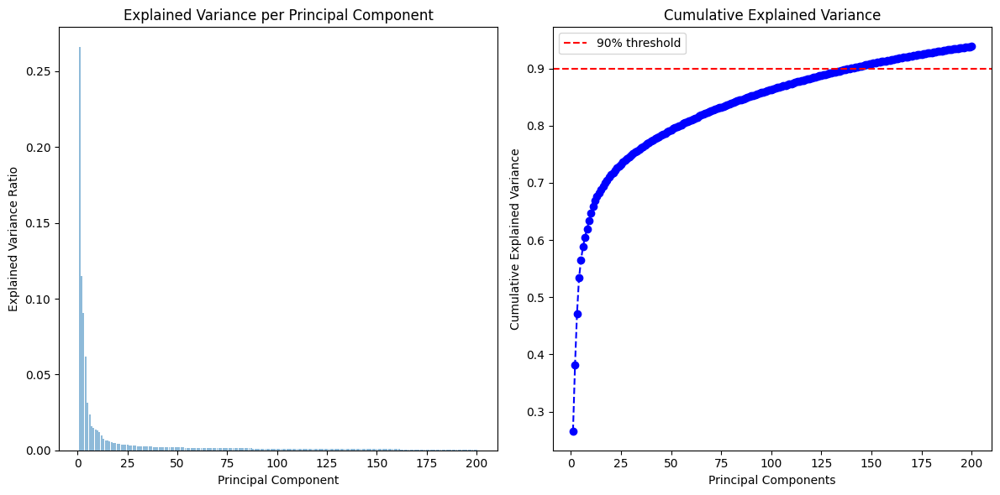

Number of PCs to explain 90% variance: 139
Top 10 loadings for first 2 PCs:
                PC1       PC2
High_2148  0.046249  0.011061
High_2120 -0.040130  0.000376
High_2130  0.039511  0.015099
High_2121 -0.027466  0.031922
High_2150  0.025335  0.020128
High_1973 -0.016902 -0.012265
High_2124 -0.015050  0.011874
High_2146  0.014758  0.008270
High_1954 -0.008193  0.046350
High_2127  0.002516  0.000155


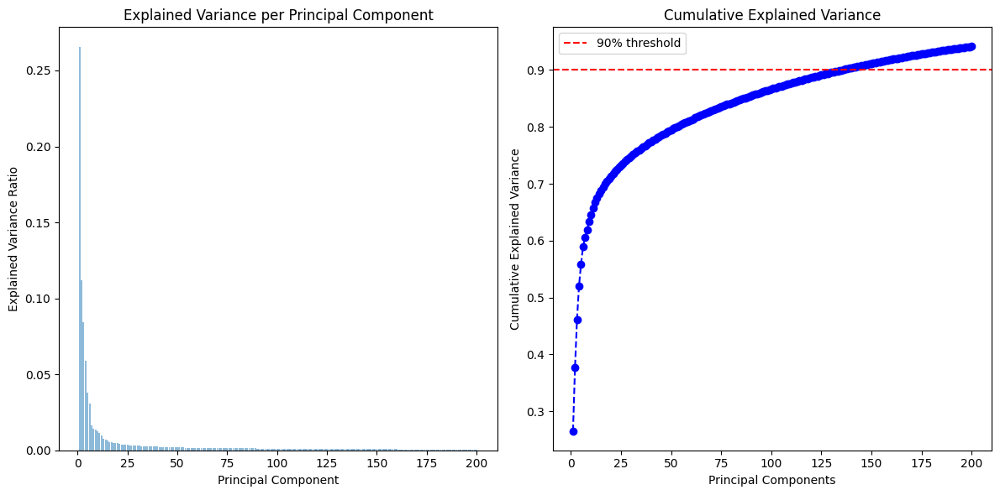

Number of PCs to explain 90% variance: 135
Top 10 loadings for first 2 PCs:
                PC1       PC2
High_2148  0.047323  0.012214
High_2120 -0.042028  0.000160
High_2130  0.038995  0.009623
High_2121 -0.026250  0.032564
High_2150  0.024721  0.010224
High_1973 -0.018666 -0.012248
High_2146  0.016140  0.010019
High_2124 -0.012991  0.009941
High_1954 -0.011829  0.048296
High_2127  0.005867  0.007228


In [ ]:
#fixes 5 yearly PCA
stocks_df['month'] = stocks_df.index.month

# Sort the data by year to ensure proper grouping
merged_sorted = stocks_df.sort_values(by='month')

# Get unique years for rolling 5-year windows
unique_months = stocks_df['month'].unique()

# Initialize a dictionary to store PCA results
pca_results = {}

# Loop over each 5-year rolling window
for i in range(len(unique_months) -4  ):
    #5 yr window
    window_months = unique_months[i:i+5]

    # Filter the data for the current 5-year window
    sequence_data = merged_sorted[merged_sorted['month'].isin(window_months)]

    # Apply PCA on the 5-year data for the first 6 PCs
    loadings = fit_visualize_pca(sequence_data, 200)

    # Store the PCA results with the last year of the window as the key
    pca_results[window_months[-1]] = loadings

### Analyzing dependencies with copulas



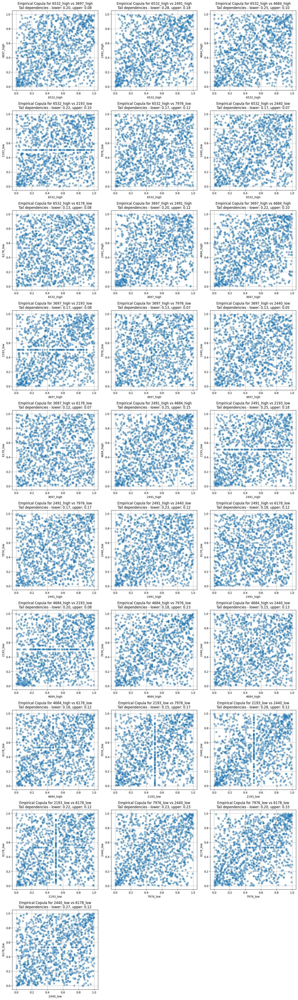

In [ ]:
def empirical_tail_dependence(u1, u2, q=0.05):
    lower = np.mean((u1 < q) & (u2 < q)) / q
    upper = np.mean((u1 > 1 - q) & (u2 > 1 - q)) / q
    return lower, upper

def plot_pairwise_empirical_copulas(data, columns):
    """
    This function generates pairwise empirical copulas and visualizes them.

    Parameters:
    - data: pandas DataFrame with the data.
    - columns: List of column names or securities codes to use for copula analysis.
    """
    # Generate all pairwise combinations of the selected columns
    col_combinations = list(combinations(columns, 2))

    # Set up the figure with a grid of subplots
    num_plots = len(col_combinations)
    rows = (num_plots // 3) + (num_plots % 3 > 0)  # Arrange subplots in rows, 3 per row
    plt.figure(figsize=(15, 5 * rows))

    # Iterate over the pairwise combinations and plot each one
    for idx, (col1, col2) in enumerate(col_combinations):
        # Rank the data and normalize to uniform marginals (copula space)
        u_1 = rankdata(data[col1]) / len(data[col1])
        u_2 = rankdata(data[col2]) / len(data[col2])

        lower_tail_dep, upper_tail_dep = empirical_tail_dependence(u_1, u_2, q=0.05)
        # Create a subplot for each pairwise combination
        plt.subplot(rows, 3, idx + 1)
        plt.scatter(u_1, u_2, alpha=0.5)
        plt.title(f'Empirical Copula for {col1} vs {col2}\nTail dependencies - lower: {lower_tail_dep:.2f}, upper: {upper_tail_dep:.2f}')
        plt.xlabel(col1)
        plt.ylabel(col2)
        plt.grid(True)

       # print(f"Empirical lower tail dependence is {lower_tail_dep} and upper tail dependence is {upper_tail_dep}")
    # Adjust layout for better readability
    plt.tight_layout()
    plt.show()

# Example usage
columns_to_analyze = selected_stocks.columns  # Example SecuritiesCodes
plot_pairwise_empirical_copulas(selected_stocks, columns_to_analyze)

In [ ]:
def create_autocopula_points(series, lag):
    """Create autocopula points by pairing the normalized ranks with their lagged versions."""
    series_normalized = rankdata(series) / len(series)
    series_lagged = np.roll(series_normalized, shift=lag)
    u1 = series_normalized[lag:]
    u2 = series_lagged[:-lag]

    lower, upper = empirical_tail_dependence(u1, u2) #get lower and upper taild dependence for autocopula
    return np.column_stack((series_normalized[:-lag], series_normalized[lag:])), lower, upper



def fit_visualize_autocopula(ax, lag, series, feature):


    autocopula, lower, upper = create_autocopula_points(series , lag)

    ax.scatter(autocopula[:, 0], autocopula[:, 1], alpha=0.5)
    ax.set_title(f'{feature} (lag {lag})\nTail dependencies - lower: {lower:.2f}, upper: {upper:.2f}')
    ax.set_xlabel(f'{feature} Rank ({lag})')
    ax.set_ylabel(f'{feature} Rank (t+1)')



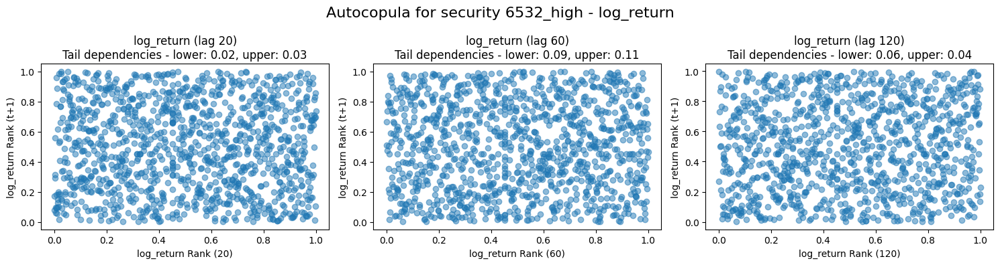

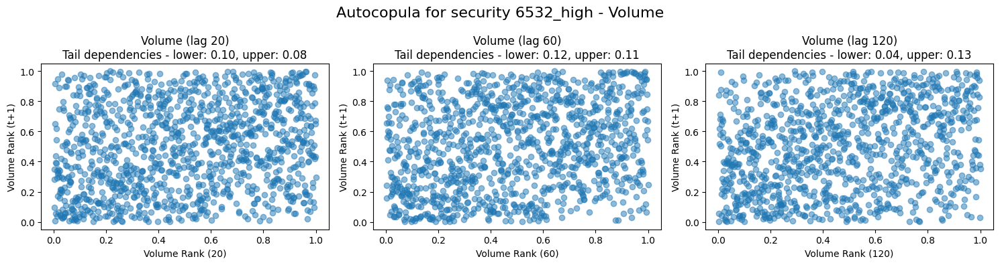

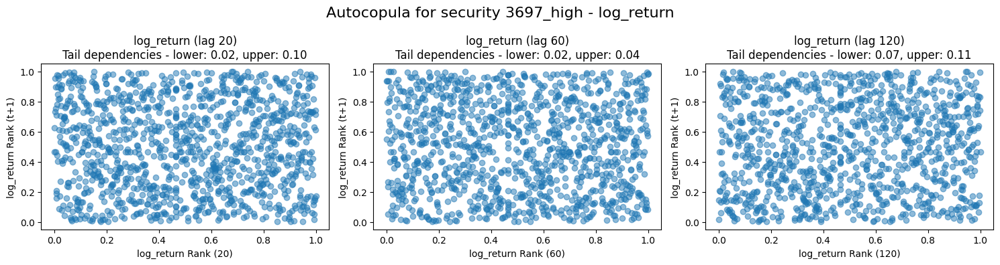

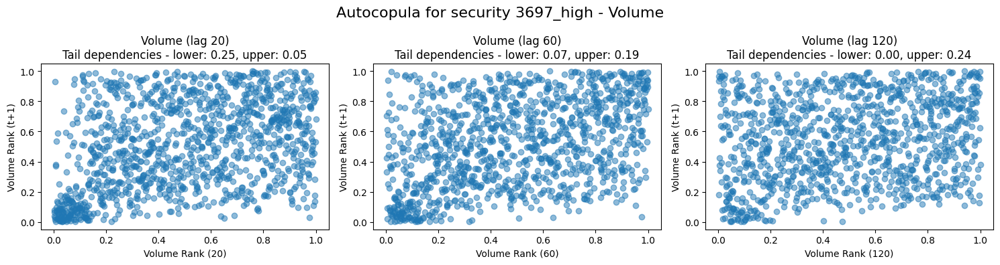

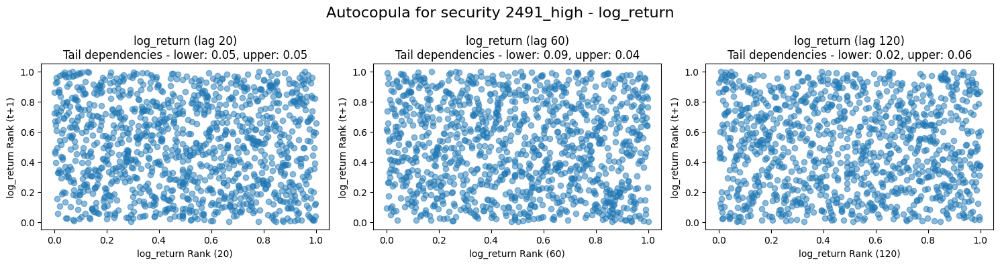

...

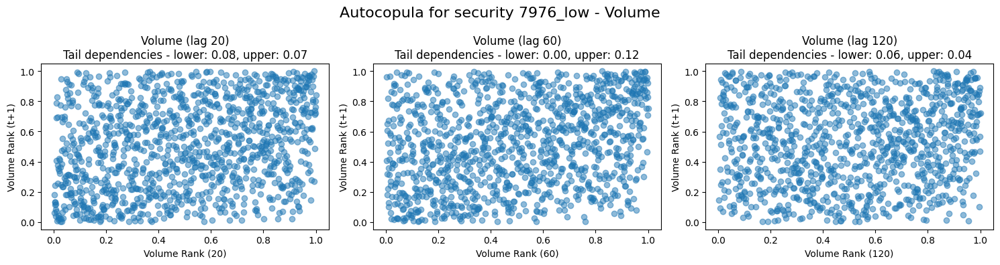

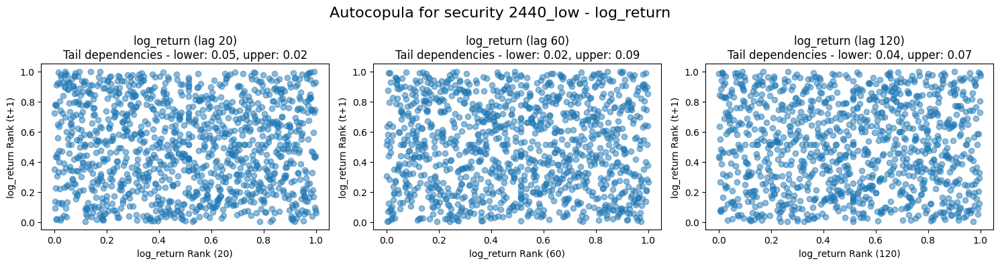

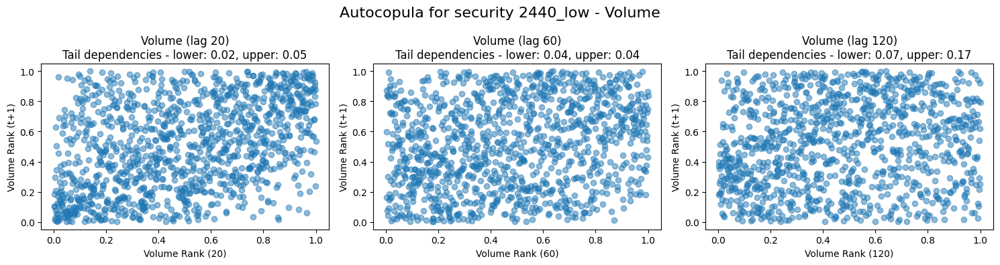

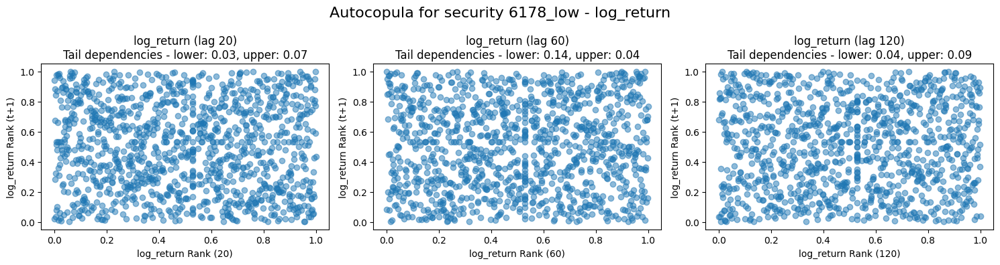

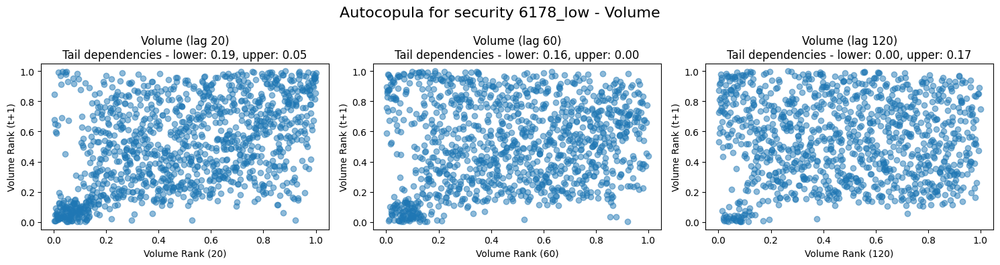

In [ ]:

lags = [20, 60, 120]

#plot autocopulas for selected stocks
for col in selected_stocks.columns:
  for feature in ['log_return', 'Volume']:
    # One row, len(lags) columns
    security = int(col.split('_')[0])
    series = cleaned_data[(feature, security)]

    fig, axes = plt.subplots(1, len(lags), figsize=(5 * len(lags), 4))

    for ax, lag in zip(axes, lags):

        fit_visualize_autocopula(ax, lag, series, feature)
    title_r = f'Autocopula for security {col} - {feature}'
    fig.suptitle(title_r, fontsize=16)
    plt.tight_layout()
    plt.show()

# Modeling

## Create sequences


In [39]:
y_values = cleaned_data[cleaned_data.columns[cleaned_data.columns.get_level_values(0) == 'log_return']]
x_values = cleaned_data.drop(columns=cleaned_data.columns[cleaned_data.columns.get_level_values(0) == 'log_return'])
x_values = (x_values - x_values.mean()) / x_values.std() #normalize

macro_data = (macro_data - macro_data.mean()) / macro_data.std()

In [50]:
X_tensor.shape

torch.Size([5148, 60, 13])

In [16]:
def create_sequences(x_values, y_values, window, horizon, macro_data):
    X_list = []
    y_list = []
    for sec in x_values.columns.levels[1]:  # loop over SecuritiesCode
        try:
            # Slice input features for this security
            x_data = x_values.xs(sec, level=1, axis=1)  # shape: (time, 5 features)
            y_data = y_values.xs(sec, level=1, axis=1)  # shape: (time, 1)

            # Ensure aligned index
            data = x_data.join(y_data, how='inner')


            #x_data = data.iloc[:, :-1]
            y_data = data.iloc[:, -1]   # last column (log_return)
            data = data.join(macro_data, how='inner')

            for i in range(0, len(data) - window - horizon, window + horizon): # step by window + horizon for each sequence
                X_seq = data.iloc[i : i + window].values  # shape: (50, 5)
                y_seq = y_data.iloc[i + window : i + window + horizon].values  # shape: (15,)
                X_list.append(X_seq)
                y_list.append(y_seq)

        except KeyError:
            continue  # in case data missing for some securities
    return X_list, y_list


In [40]:

window = 60
horizon = 20

#cleaned_data = cleaned_data[29:]# cut end data to have only 50-15 windows

total_len = len(cleaned_data)
seq_len = window + horizon
usable_len = (total_len // seq_len) * seq_len
cleaned_data = cleaned_data[:usable_len]
print(f"Number of sequences: {usable_len // seq_len}")
X_list, y_list = create_sequences(x_values, y_values, window, horizon, macro_data)


X_tensor = torch.tensor(X_list, dtype=torch.float32)
y_tensor = torch.tensor(y_list, dtype=torch.float32)

sec_num = len(cleaned_data.columns.levels[1]) #sequences for the last time window
total_sec = len(X_list)#total number of

#train/val size in batches
val_test_size = 1
val_size = 1

train_indices = list(range(total_sec - sec_num))
test_indices = list(range(total_sec - val_test_size*sec_num,total_sec))
val_indices = list(range(total_sec - 2*val_test_size*sec_num,total_sec-val_test_size*sec_num))


train_X = X_tensor[train_indices]
train_y = torch.sum(y_tensor[train_indices], dim=1)

val_X = X_tensor[val_indices]
val_y = torch.sum(y_tensor[val_indices], dim=1)

test_X = X_tensor[test_indices]
test_y = torch.sum(y_tensor[test_indices], dim=1)


train_dataset = TensorDataset(train_X, train_y)
val_dataset = TensorDataset(val_X, val_y)
test_dataset = TensorDataset(test_X, test_y)

# Create DataLoaders for both train and test sets
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=False)
val_loader = DataLoader(val_dataset,batch_size=64, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

Number of sequences: 13


## LSTM architecture + train

In [18]:
#classic lstm

class LSTMForecast(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(LSTMForecast, self).__init__()
        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size, num_layers = 2,  batch_first=True)
        self.dropout = nn.Dropout(0.2)
        self.linear = nn.Linear(hidden_size, 1)  # Output a single value = cumulative return

        self.apply(self.init_weights)

    def init_weights(self, m):
        if isinstance(m, nn.Linear):
            init.xavier_uniform_(m.weight)
            if m.bias is not None:
                init.zeros_(m.bias)
        elif isinstance(m, nn.LSTM):
            for name, param in m.named_parameters():
                if 'weight_ih' in name:
                    init.xavier_uniform_(param)
                elif 'weight_hh' in name:
                    init.orthogonal_(param)
                elif 'bias' in name:
                    init.zeros_(param)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        last_hidden = lstm_out[:, -1, :]
        out = self.dropout(last_hidden)          # shape: (batch, hidden)
        out = self.linear(out)            # shape: (batch, 1)
        return out.squeeze(-1)


class MAEloss(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, pred_log, target_log):
        pred = torch.exp(pred_log) - 1
        target = torch.exp(target_log) - 1
        return torch.mean(torch.abs(pred - target))

In [19]:
#LSTM with self attention

class LSTMSelfAttention(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(LSTMSelfAttention, self).__init__()
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size, num_layers=2,dropout = 0.2, batch_first=True)
        self.attn = nn.Linear(hidden_size, 1)  # For computing attention scores
        self.dropout = nn.Dropout(0.2)
        self.linear = nn.Linear(hidden_size, 1)  # Output a single value = cumulative return

        self.apply(self.init_weights)

    def init_weights(self, m):
        if isinstance(m, nn.Linear):
            init.xavier_uniform_(m.weight)
            if m.bias is not None:
                init.zeros_(m.bias)
        elif isinstance(m, nn.LSTM):
            for name, param in m.named_parameters():
                if 'weight_ih' in name:
                    init.xavier_uniform_(param)
                elif 'weight_hh' in name:
                    init.orthogonal_(param)
                elif 'bias' in name:
                    init.zeros_(param)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)  # shape: (batch, seq_len, hidden_size)

        # Compute attention scores and weights
        attn_scores = self.attn(lstm_out).squeeze(-1)  # shape: (batch, seq_len)
        attn_weights = F.softmax(attn_scores, dim=1)   # shape: (batch, seq_len)

        # Weighted sum of LSTM outputs
        context = torch.sum(lstm_out * attn_weights.unsqueeze(-1), dim=1)  # shape: (batch, hidden_size)

        out = self.dropout(context)
        out = self.linear(out)  # shape: (batch, 1)
        return out.squeeze(-1)

In [20]:
def epoch_step(model, dataloader, loss_fn, device, optimizer=None, train=True):
    loss_values = []
    train_preds = []  # To store model predictions

    for X_batch, y_batch in dataloader:
        X_batch, y_batch = X_batch.to(device), y_batch.to(device)+torch.randn_like(y_batch) * 0.01

        if train:
            optimizer.zero_grad()
            preds = model(X_batch)
        else:
            with torch.no_grad():
                preds = model(X_batch)

        # Calculate Mean Squared Error for regression
        loss_value = loss_fn(preds, y_batch)
        loss_values.append(loss_value.item())

        # Store predictions (if needed for analysis)
        train_preds.append(preds.cpu().detach().numpy())  # Store predictions as NumPy arrays for later

        if train:
            loss_value.backward()  # Backpropagate gradients
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()  # Update model parameters

    return loss_values, train_preds


def train_model(model, train_data, val_data, loss_fn, optimizer, device, early_stopping, num_epochs=10):
    train_losses, train_preds = [], []  # To track both loss and predictions per epoch
    val_losses, val_preds = [], []

    for epoch in tqdm(range(num_epochs)):
        model.train()  # Switch model to training mode
        batch_losses, batch_preds = epoch_step(model, train_data, loss_fn, device, optimizer,  train = True)

        train_losses.append(np.mean(batch_losses))  # Average batch losses over the epoch
        train_preds.append(np.concatenate(batch_preds, axis=0))  # Concatenate batch predictions over the epoch

        model.eval()  # Set model to evaluation mode
        val_loss_values, val_batch_preds = epoch_step(model, val_data, loss_fn, device, optimizer=None, train=False)
        val_losses.append(np.mean(val_loss_values))  # Average validation losses
        val_preds.append(np.concatenate(val_batch_preds, axis=0))

        print(f"Epoch {epoch+1}/{num_epochs} - "
              f"Train Loss: {train_losses[-1]:.4f} - "
              f'Validation loss: {val_losses[-1]:.4f}')

        early_stopping(np.mean(val_loss_values), model)
        if early_stopping.early_stop:
            model.load_state_dict(early_stopping.best_model)
            print("Early stopping triggered.")
            break

    return train_losses, train_preds, val_losses, val_preds  # Return losses and all predictions over all epochs

In [21]:
import copy

class EarlyStopping:
    def __init__(self, patience=5, delta=0.0001, verbose=False):
        self.patience = patience
        self.delta = delta
        self.verbose = verbose
        self.best_loss = float('inf')
        self.counter = 0
        self.early_stop = False
        self.best_model = None

    def __call__(self, val_loss, model=None):
        if val_loss < self.best_loss - self.delta:
            self.best_loss = val_loss
            self.counter = 0
            self.early_stop = False
            if model is not None:
                self.best_model = copy.deepcopy(model.state_dict())
            if self.verbose:
                print(f"Validation loss decreased to {val_loss:.5f}. Resetting patience.")
        else:
            self.counter += 1
            if self.verbose:
                print(f"No improvement in validation loss for {self.counter}/{self.patience} epochs.")
            if self.counter >= self.patience:
                self.early_stop = True
                if self.verbose:
                    print("Early stopping triggered.")

In [51]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = LSTMForecast(input_size=X_tensor.shape[2], hidden_size=128)
#loss_fn = MAELoss()  # Assuming MSE loss for time series

loss_fn = MAEloss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
early_stopping = EarlyStopping(patience=3)


train_losses, train_preds, val_losses, val_preds = train_model(
    model, train_loader, val_loader, loss_fn, optimizer, device , early_stopping, num_epochs=30
)


  3%|▎         | 1/30 [00:16<07:51, 16.27s/it]

Epoch 1/30 - Train Loss: 0.1008 - Validation loss: 0.0944


  7%|▋         | 2/30 [00:33<07:54, 16.94s/it]

Epoch 2/30 - Train Loss: 0.0951 - Validation loss: 0.0940


 10%|█         | 3/30 [00:51<07:45, 17.25s/it]

Epoch 3/30 - Train Loss: 0.0931 - Validation loss: 0.0928


 13%|█▎        | 4/30 [01:08<07:23, 17.05s/it]

Epoch 4/30 - Train Loss: 0.0918 - Validation loss: 0.0915


 17%|█▋        | 5/30 [01:24<07:03, 16.94s/it]

Epoch 5/30 - Train Loss: 0.0909 - Validation loss: 0.0899


 20%|██        | 6/30 [01:42<06:56, 17.37s/it]

Epoch 6/30 - Train Loss: 0.0903 - Validation loss: 0.0911


 23%|██▎       | 7/30 [02:00<06:42, 17.52s/it]

Epoch 7/30 - Train Loss: 0.0891 - Validation loss: 0.0895


 27%|██▋       | 8/30 [02:17<06:22, 17.38s/it]

Epoch 8/30 - Train Loss: 0.0880 - Validation loss: 0.0887


 30%|███       | 9/30 [02:35<06:06, 17.46s/it]

Epoch 9/30 - Train Loss: 0.0869 - Validation loss: 0.0893


 33%|███▎      | 10/30 [02:53<05:50, 17.51s/it]

Epoch 10/30 - Train Loss: 0.0858 - Validation loss: 0.0869


 37%|███▋      | 11/30 [03:09<05:27, 17.23s/it]

Epoch 11/30 - Train Loss: 0.0855 - Validation loss: 0.0860


 40%|████      | 12/30 [03:26<05:05, 16.97s/it]

Epoch 12/30 - Train Loss: 0.0841 - Validation loss: 0.0867


 43%|████▎     | 13/30 [03:42<04:46, 16.88s/it]

Epoch 13/30 - Train Loss: 0.0838 - Validation loss: 0.0871


 43%|████▎     | 13/30 [03:59<05:13, 18.44s/it]

Epoch 14/30 - Train Loss: 0.0833 - Validation loss: 0.0862
Early stopping triggered.


In [52]:
# Subsample indices
#idx = np.random.choice(len(test_y), size=5000, replace=False)

def plot_model_perf(actual, predicted):

  residuals = actual - predicted
  # Scatter plot
  plt.figure(figsize=(10, 6))
  plt.scatter(actual, predicted, alpha=0.3, label='Predictions')
  plt.xlabel('Actual Cumulative Returns', fontsize=14)
  plt.ylabel('Predicted Cumulative Returns', fontsize=14)
  plt.title('Actual vs Predicted Cumulative Returns', fontsize=16)
  plt.axis('equal')
  plt.grid(True)
  plt.xlim(-0.5,0.5)
  plt.ylim(-0.5, 0.5)
  plt.legend()
  plt.show()



  plt.figure(figsize=(10, 6))
  plt.scatter(predicted, residuals, alpha=0.3)
  plt.axhline(0, color='red', linestyle='--', label="Zero Residual Line")
  plt.xlabel('Actual Values', fontsize=14)
  plt.ylabel('Residuals (Actual - Predicted)', fontsize=14)
  plt.title('Residual Plot', fontsize=16)
  plt.grid(True)
  plt.legend()
  plt.show()


  # Histogram of Residuals (distribution of errors)

  plt.figure(figsize=(10, 6))
  plt.hist(predicted, alpha=0.3, bins = 100)
  plt.title('Distribution of Residuals', fontsize=16)
  plt.xlabel('Residuals (Actual - Predicted)', fontsize=14)
  plt.ylabel('Frequency', fontsize=14)
  plt.grid(True)
#  plt.xlim(0.95,1.05)
  plt.show()


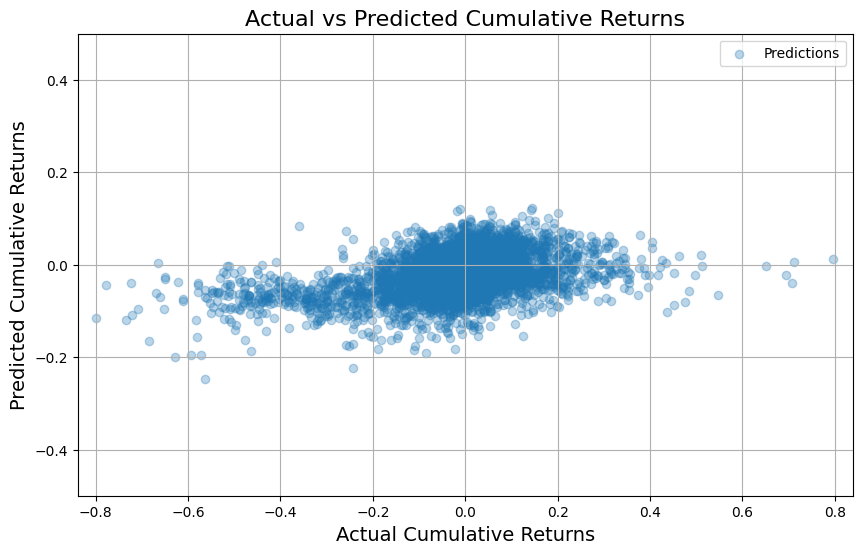

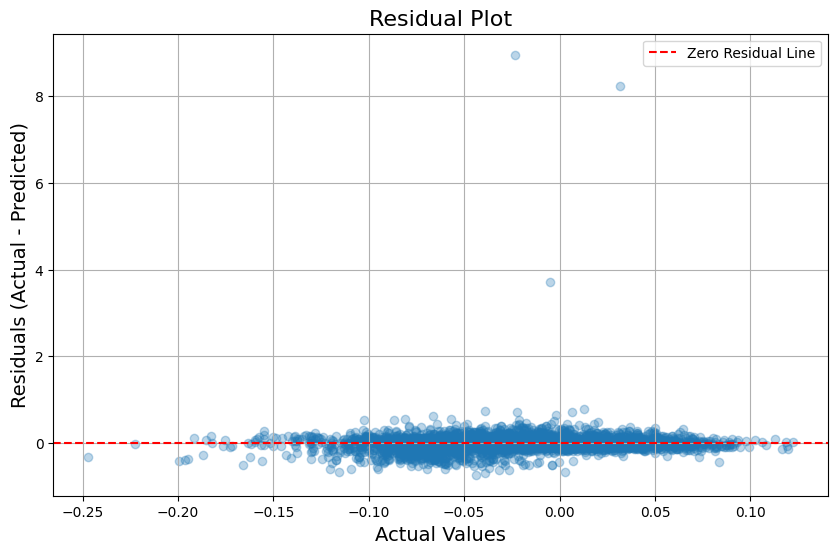

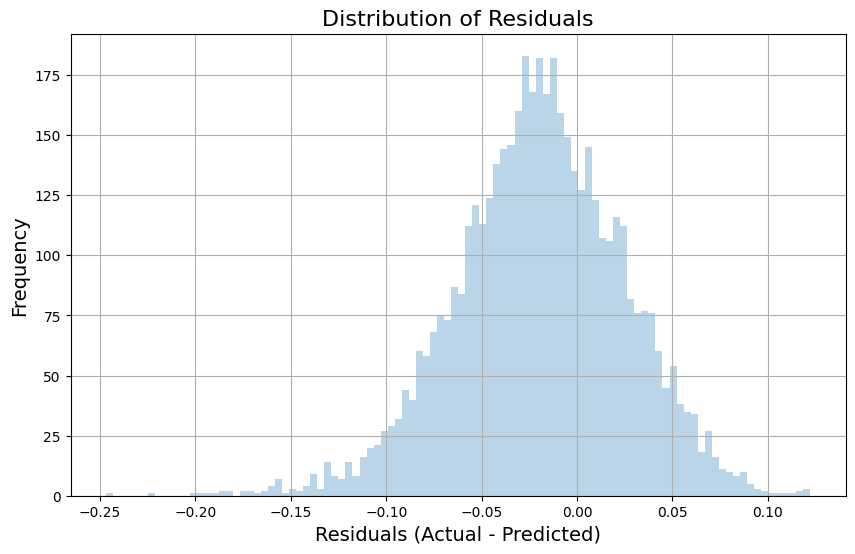

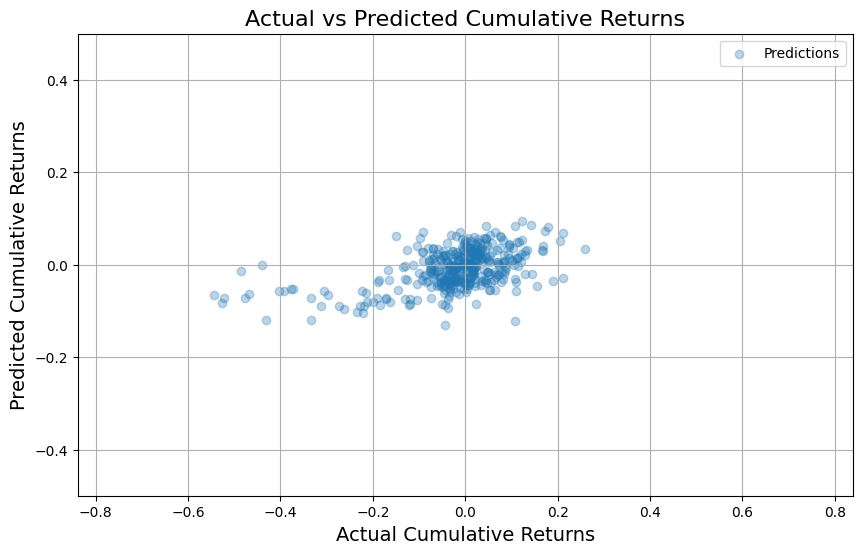

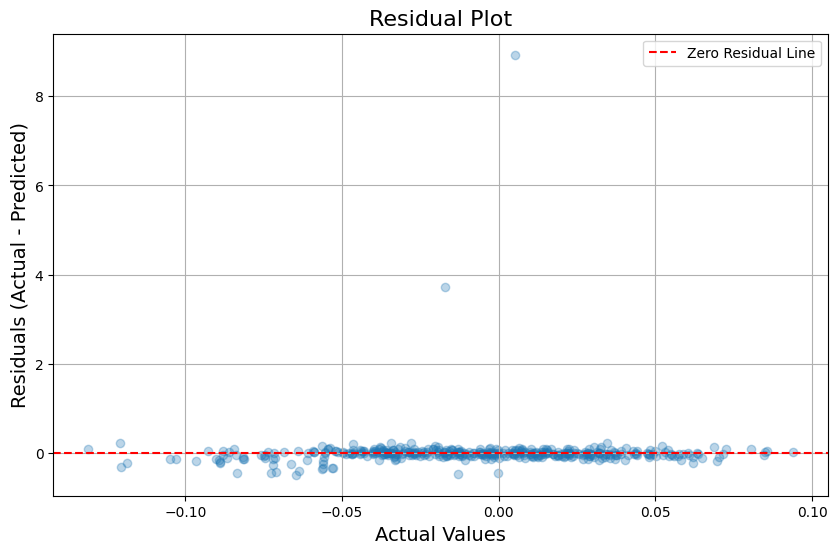

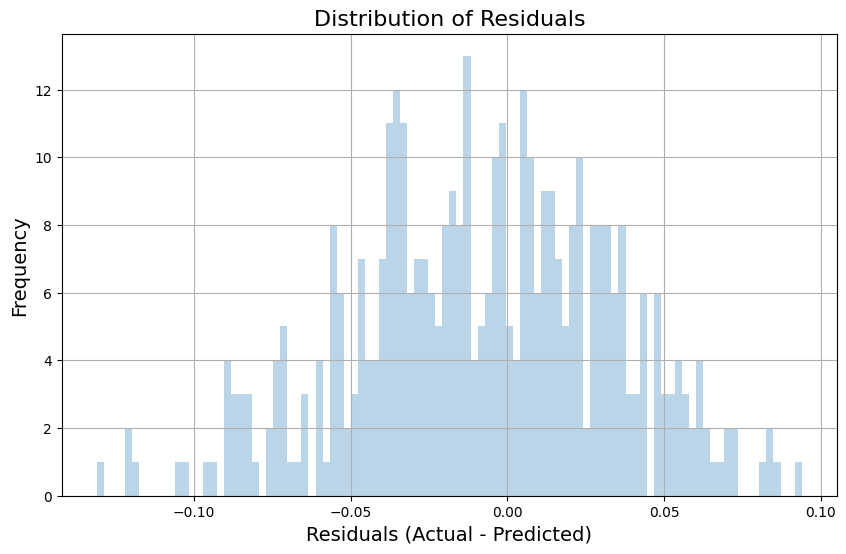

In [53]:
y_train = (np.exp(train_y.numpy())-1)
y_train_pred = (np.exp(train_preds[1])-1)

y_val = (np.exp(val_y.numpy())-1)
y_val_pred = (np.exp(val_preds[1])-1)

plot_model_perf(y_train, y_train_pred)
plot_model_perf(y_val, y_val_pred)

In [54]:
model.eval()  # important: sets dropout/batchnorm to eval mode
predictions = []
actuals = []

with torch.no_grad():  # no gradients = no training
    for X_batch, y_batch in test_loader:
        output = model(X_batch)  # shape: (batch_size,) — predicted cumulative log return
        predictions.append(output)
        actuals.append(y_batch)  # target cumulative log return

# Concatenate and flatten all batches
predictions_flat = torch.cat(predictions).cpu().numpy().flatten()
actuals_flat = torch.cat(actuals).cpu().numpy().flatten()

# Convert from cumulative log returns to normal cumulative returns
preds_norm = np.exp(predictions_flat) - 1
actuals_norm = np.exp(actuals_flat) - 1

print("Sample predicted cumulative returns:", preds_norm[:5])
print("Sample actual cumulative returns:", actuals_norm[:5])



Sample predicted cumulative returns: [ 0.01571703  0.00495994  0.05827999 -0.2087518  -0.00905716]
Sample actual cumulative returns: [ 0.01734698 -0.00199604 -0.00797206 -0.37067205 -0.07084471]


In [41]:
x_values

Close                                                    \
SecuritiesCode      1954      1973      2120      2121      2124      2127   
Date                                                                         
2017-04-06     -0.541850 -0.738000  0.566163  1.576181 -0.175053 -0.342204   
2017-04-07     -0.470265 -0.689589  0.580682  1.725508 -0.252835 -0.268753   
2017-04-10     -0.433238 -0.679622  0.566163  1.874835 -0.278762 -0.239373   
2017-04-11     -0.475202 -0.703828  0.571003  1.682843 -0.443753 -0.250390   
2017-04-12     -0.507292 -0.739424  0.430647  1.647289 -0.582818 -0.283443   
...                  ...       ...       ...       ...       ...       ...   
2021-08-03      0.287550 -0.883234 -1.403660 -0.307468 -0.394256 -0.724150   
2021-08-04      0.016020 -0.883234 -1.456898 -0.335200 -0.469681 -0.742513   
2021-08-05      0.003678 -0.933070 -1.447218 -0.335200 -0.521535 -0.720477   
2021-08-06      0.139443 -0.940189 -1.437539 -0.348711 -0.512107 -0.716805   
2021-08-10     -0.001259 -0.937341 -1.408500 -0.462483 -0.389542 -0.676407   

                                                        ...     1m_ma  \
SecuritiesCode      2130      2146      2148      2150  ...      9793   
Date                                                    ...             
2017-04-06     -1.508736 -1.782403 -0.627266 -0.561552  ... -0.952912   
2017-04-07     -1.528806 -1.740450 -0.589087 -0.550619  ... -0.164942   
2017-04-10     -1.515904 -1.743157 -0.596429 -0.541247  ...  0.025231   
2017-04-11     -1.523072 -1.844656 -0.614050 -0.554263  ... -0.350322   
2017-04-12     -1.558911 -1.906908 -0.653698 -0.576651  ... -0.307246   
...                  ...       ...       ...       ...  ...       ...   
2021-08-03      1.733989  0.667099  1.400624  2.629995  ...  1.056824   
2021-08-04      1.531856  0.565600  1.250845  2.598757  ...  0.669394   
2021-08-05      1.494583  0.443802  1.286087  2.603963  ...  0.461975   
2021-08-06      1.474513  0.443802  1.318393  2.452976  ...  0.092874   
2021-08-10      1.609269  0.403202  1.449082  2.702886  ...  0.178410   

                   3m_ma     1m_ma     3m_ma     1m_ma     3m_ma     1m_ma  \
SecuritiesCode      9793      9795      9795      9889      9889      9928   
Date                                                                         
2017-04-06     -0.882761  0.817636  0.608936 -0.940772 -0.742605  1.008645   
2017-04-07     -0.316489  0.540259  0.546789 -1.061163 -0.738287  1.302301   
2017-04-10      0.242309  0.615651  0.672655 -1.073842 -0.849744  1.529298   
2017-04-11      0.286680  0.095488  0.441267 -0.873439 -0.769770  1.372717   
2017-04-12      0.306629 -0.060663  0.432153 -1.062349 -0.710738  1.694152   
...                  ...       ...       ...       ...       ...       ...   
2021-08-03      1.427533  1.686809  0.829619  0.355365  0.481377 -0.045042   
2021-08-04      1.312857  1.156241  0.768953  0.135886  0.227488 -0.221582   
2021-08-05      1.265519  0.631953  0.619416 -0.061520  0.122987 -0.380667   
2021-08-06      1.128425  0.564211  0.686720 -0.331984  0.024228 -0.349506   
2021-08-10      1.186011  0.551949  0.670188 -0.211173  0.097901 -0.245942   

                   3m_ma     1m_ma     3m_ma  
SecuritiesCode      9928      9984      9984  
Date                                          
2017-04-06      0.334634 -0.448248 -0.097298  
2017-04-07      0.636027 -0.329602 -0.149058  
2017-04-10      0.800033 -0.241881 -0.170351  
2017-04-11      0.990688 -0.273834 -0.203846  
2017-04-12      1.194617 -0.454529 -0.255803  
...                  ...       ...       ...  
2021-08-03     -1.038334 -0.722373 -1.331222  
2021-08-04     -0.988399 -0.867495 -1.369511  
2021-08-05     -1.069063 -0.553966 -1.459155  
2021-08-06     -1.119164 -0.630969 -1.450228  
2021-08-10     -1.215439 -0.530270 -1.479956  

[1057 rows x 2376 columns]

## Synthetic data generation

In [23]:
class Generator(nn.Module):
    def __init__(self, latent_dim, feature_dim, seq_len=60):
        super(Generator, self).__init__()
        self.latent_dim = latent_dim
        self.feature_dim = feature_dim
        self.seq_len = seq_len

        # Shared layers
        self.shared = nn.Sequential(
            nn.Linear(latent_dim, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 4 * seq_len + 128),
            nn.LeakyReLU(0.2),
            nn.Linear(4 * seq_len + 128, feature_dim * seq_len + 128),
            nn.LeakyReLU(0.2),
        )

        # Separate heads
        self.seq_head = nn.Linear(feature_dim * seq_len + 128, feature_dim * seq_len)
        self.scalar_head = nn.Linear(feature_dim * seq_len + 128, 1)

    def forward(self, z):
        x = self.shared(z)
        seq_out = self.seq_head(x)  # Output vector for sequence
        scalar_out = self.scalar_head(x)  # Output scalar

        # Reshape sequence output to (batch, features, seq_len)
        seq_out = seq_out.view(-1, self.seq_len, self.feature_dim)

        return seq_out, scalar_out.squeeze(1)  # scalar_out: (batch,)


class Discriminator(nn.Module):
    def __init__(self, seq_len, feature_dim , hidden_dim=128, num_layers=1):
        super(Discriminator, self).__init__()
        self.feature_dim = feature_dim
        self.seq_len = seq_len
        self.hidden_dim = hidden_dim

        # LSTM for sequence modeling
        self.lstm = nn.LSTM(
            input_size=feature_dim,
            hidden_size=hidden_dim,
            num_layers=num_layers,
            batch_first=True,
            bidirectional=False  # Set to True if you want bidirectional LSTM
        )

        # Final layers after concatenating scalar
        self.final_net = nn.Sequential(
            nn.Linear(hidden_dim + 1, 128),
            nn.LeakyReLU(0.2),
            nn.Linear(128, 1),
        )

    def forward(self, seq, scalar):

        # LSTM output: (batch, seq_len, hidden_dim), (h_n, c_n)
        _, (h_n, _) = self.lstm(seq)  # h_n shape: (num_layers, batch, hidden_dim)

        # Use the last hidden state from the last layer
        h_last = h_n[-1]  # shape: (batch, hidden_dim)

        combined = torch.cat([h_last, scalar.unsqueeze(1)], dim=1)
        validity = self.final_net(combined)

        return validity.squeeze(1)  # output shape: (batch,)

In [26]:
def compute_gradient_penalty(D, real_samples, fake_samples, real_scalar, fake_scalar):
    alpha = torch.rand(real_samples.size(0), 1, 1).to(real_samples.device)  # for sequences: broadcast to (batch, seq_len, features)
    # Interpolate between real and fake sequences
    interpolates_seq = (alpha * real_samples + ((1 - alpha) * fake_samples)).requires_grad_(True)

    alpha_scalar = alpha.squeeze(-1).squeeze(-1)  # adjust shape for scalar, or use different alpha for scalar too
    interpolates_scalar = (alpha_scalar * real_scalar + (1 - alpha_scalar) * fake_scalar).requires_grad_(True)

    d_interpolates = D(interpolates_seq, interpolates_scalar)

    # Get gradients wrt inputs
    gradients = torch.autograd.grad(
        outputs=d_interpolates,
        inputs=[interpolates_seq, interpolates_scalar],
        grad_outputs=torch.ones_like(d_interpolates),
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )

    # Flatten gradients for sequence and scalar, then concatenate (or compute norm for each separately and sum)
    grad_seq = gradients[0].reshape(gradients[0].size(0), -1)
    grad_scalar = gradients[1].reshape(gradients[1].size(0), -1)
    gradients_all = torch.cat([grad_seq, grad_scalar], dim=1)

    gradient_norm = gradients_all.norm(2, dim=1)
    gradient_penalty = ((gradient_norm - 1) ** 2).mean()
    return gradient_penalty

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

latent_dim = 100
feature_dim = train_X[0].shape[1] # number of features
seq_len = 60
G = Generator(latent_dim, feature_dim, seq_len).to(device)
D = Discriminator(seq_len,feature_dim).to(device)
lambda_gp = 5
# Optimizers
lr = 0.00001
optimizer_D = torch.optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.9))
optimizer_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.9))

# Hyperparams
n_critic = 5          # discriminator updates per generator update
clip_value = 0.01     # weight clipping for discriminator
num_epochs = 10
batch_size = 64

def train_gan(G, D, dataloader, optimizer_G, optimizer_D, device,
              latent_dim=100, n_critic=5, clip_value=0.01, num_epochs=10):
    G.to(device)
    D.to(device)

    for epoch in range(num_epochs):
        for i, (real_X, real_y) in enumerate(dataloader):
            real_X = real_X.to(device)    # (batch, features, seq_len)
            real_y = real_y.to(device)    # (batch,)

            # Train Discriminator n_critic times
            for _ in range(n_critic):

                #sample from prior distribution
                #z = torch.randn(real_X.size(0), latent_dim).to(device)
                z = torch.tensor(np.random.standard_t(df=3, size=(real_X.size(0), latent_dim)), dtype=torch.float32).to(device)
                fake_X, fake_y = G(z)

                optimizer_D.zero_grad()

                real_validity = D(real_X, real_y)

                fake_validity = D(fake_X.detach(), fake_y.detach())

                # gradient_penalty = compute_gradient_penalty(D, real_X, fake_X.detach(), real_y, fake_y.detach())
                # d_loss = -(torch.mean(real_validity) - torch.mean(fake_validity)) + lambda_gp * gradient_penalty

                d_loss = -(torch.mean(real_validity) - torch.mean(fake_validity))
                d_loss.backward()
                optimizer_D.step()

               # Weight clipping for WGAN
                for p in D.parameters():
                    p.data.clamp_(-clip_value, clip_value)

            # Train Generator
            optimizer_G.zero_grad()

            #z = torch.randn(real_X.size(0), latent_dim).to(device)
            z = torch.from_numpy(np.random.standard_t(df=3, size=(batch_size, latent_dim))).float().to(device)
            fake_X, fake_y = G(z)

            gen_validity = D(fake_X, fake_y)
            g_loss = -torch.mean(gen_validity)

            g_loss.backward()
            optimizer_G.step()

        print(f"[Epoch {epoch+1}/{num_epochs}] D loss: {d_loss.item():.4f}, G loss: {g_loss.item():.4f}")


wgan = train_gan(G, D, train_loader,optimizer_G, optimizer_D, num_epochs=30, latent_dim=100, device=device)

[Epoch 1/30] D loss: -0.0001, G loss: -0.0010
[Epoch 2/30] D loss: -0.0001, G loss: -0.0008
[Epoch 3/30] D loss: -0.0004, G loss: -0.0000
[Epoch 4/30] D loss: -0.0007, G loss: -0.0001
[Epoch 5/30] D loss: -0.0016, G loss: 0.0003
[Epoch 6/30] D loss: -0.0034, G loss: -0.0001
[Epoch 7/30] D loss: -0.0066, G loss: -0.0008
[Epoch 8/30] D loss: -0.0096, G loss: -0.0012
[Epoch 9/30] D loss: -0.0123, G loss: -0.0007
[Epoch 10/30] D loss: -0.0122, G loss: -0.0024
[Epoch 11/30] D loss: -0.0108, G loss: -0.0039
[Epoch 12/30] D loss: -0.0186, G loss: 0.0058
[Epoch 13/30] D loss: -0.0102, G loss: -0.0044
[Epoch 14/30] D loss: -0.0061, G loss: -0.0053
[Epoch 15/30] D loss: -0.0154, G loss: 0.0018
[Epoch 16/30] D loss: -0.0061, G loss: -0.0130
[Epoch 17/30] D loss: -0.0135, G loss: 0.0066
[Epoch 18/30] D loss: -0.0092, G loss: 0.0023
[Epoch 19/30] D loss: -0.0127, G loss: -0.0033
[Epoch 20/30] D loss: -0.0214, G loss: -0.0132
[Epoch 21/30] D loss: 0.0099, G loss: -0.0294
[Epoch 22/30] D loss: -0.014

In [ ]:
#save + download model

from google.colab import files
import datetime
now = datetime.datetime.now()
print(now)
# Save generator and discriminator state_dict
torch.save(G.state_dict(), f"generator_{now.date()}_{now.hour}.pth")
torch.save(D.state_dict(),f"discriminator_{now.date()}_{now.hour}.pth")

files.download(f"generator_{now.date()}_{now.hour}.pth")
files.download(f"discriminator_{now.date()}_{now.hour}.pth")

In [43]:
from google.colab import files

uploaded = files.upload()  # This opens a file picker dialog to upload files from your PC

# After uploading, the files are accessible by their filename in the Colab VM
generator_path = "generator_2025-05-29_18.pth"


# Then load:
G.load_state_dict(torch.load(generator_path))


Saving generator_2025-05-29_18 (1).pth to generator_2025-05-29_18 (1) (1).pth


RuntimeError: Error(s) in loading state_dict for Generator:
	Missing key(s) in state_dict: "shared.6.weight", "shared.6.bias". 
	size mismatch for shared.4.weight: copying a param with shape torch.Size([788, 512]) from checkpoint, the shape in current model is torch.Size([368, 512]).
	size mismatch for shared.4.bias: copying a param with shape torch.Size([788]) from checkpoint, the shape in current model is torch.Size([368]).
	size mismatch for seq_head.weight: copying a param with shape torch.Size([660, 788]) from checkpoint, the shape in current model is torch.Size([780, 908]).
	size mismatch for seq_head.bias: copying a param with shape torch.Size([660]) from checkpoint, the shape in current model is torch.Size([780]).
	size mismatch for scalar_head.weight: copying a param with shape torch.Size([1, 788]) from checkpoint, the shape in current model is torch.Size([1, 908]).

In [53]:
#generate samples

G.eval()
num_samples = 100000
z = torch.randn(num_samples, latent_dim).to(device)

with torch.no_grad():
    generated_seq, generated_scalar = G(z)

# Move to CPU and reshape for plotting

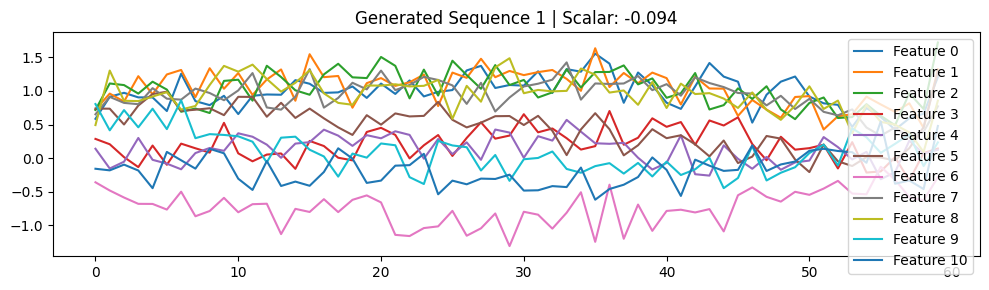

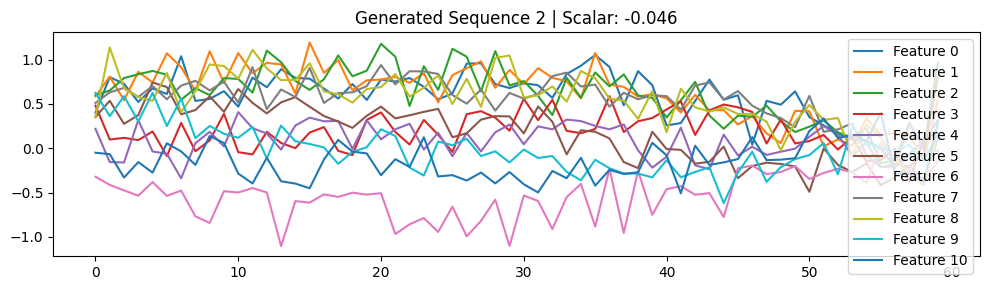

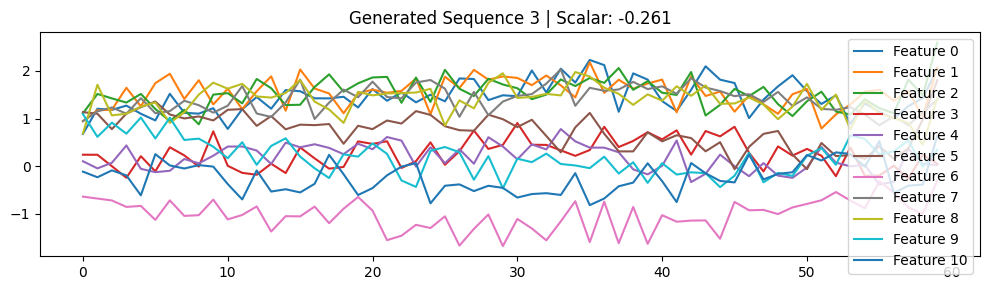

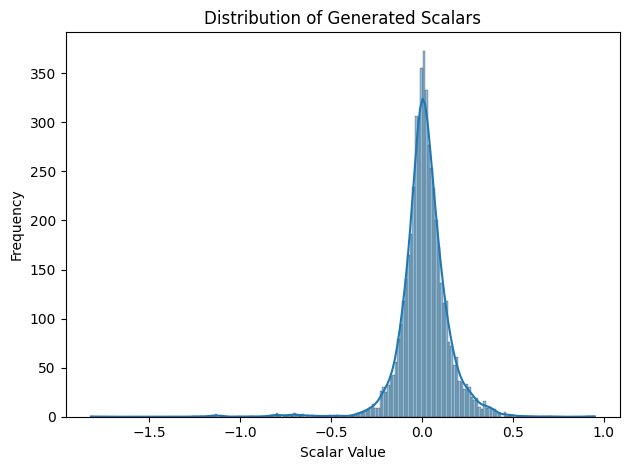

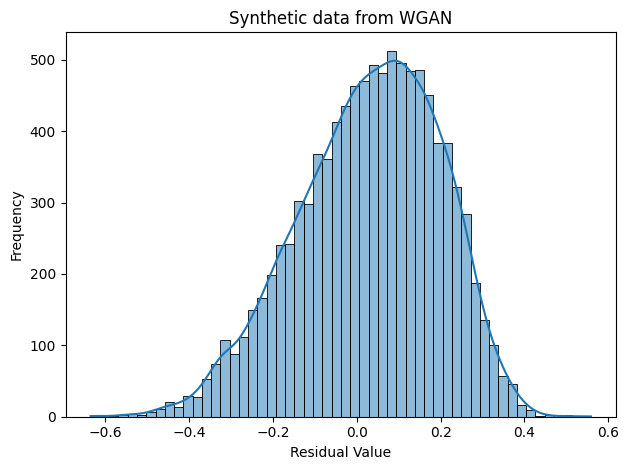

In [50]:
# Plot a few generated sequences
for i in range(3):
    plt.figure(figsize=(10, 3))
    for f in range(feature_dim):
        plt.plot(generated_seq[i, :, f], label=f'Feature {f}')
    plt.title(f"Generated Sequence {i+1} | Scalar: {generated_scalar[i]:.3f}")
    plt.legend()
    plt.tight_layout()
    plt.show()

#plot original y distribution
sns.histplot(train_y, kde=True)
plt.title("Distribution of Generated Scalars")
plt.xlabel("Scalar Value")
plt.ylabel("Frequency")
plt.tight_layout()
plt.show()

#plot generated y distribution
sns.histplot(generated_scalar, kde=True)
plt.title("Synthetic data from WGAN")
plt.xlabel("Residual Value")
plt.ylabel("Frequency")
plt.tight_layout()
plt.show()

0


KeyboardInterrupt: 

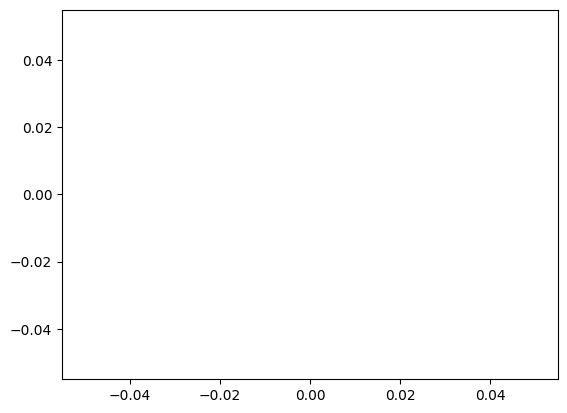

In [47]:
#plot original and generated X features

for feature_index in range(train_X.shape[2]):
  print(feature_index) # which feature to plot
  feature_data = train_X[:, :, feature_index].flatten().cpu().numpy()

  sns.histplot(feature_data, kde=True)
  plt.title(f"Distribution of original Feature {feature_index}")
  plt.tight_layout()
  plt.show()

for feature_index in range(train_X.shape[2]):
  print(feature_index) # which feature to plot
  feature_data = generated_seq[:, :, feature_index].flatten().cpu().numpy()

  sns.histplot(feature_data, kde=True)
  plt.title(f"Distribution of generated Feature {feature_index}")
  plt.tight_layout()
  plt.show()

In [56]:
print(f'train_y stats: \n')
print(f'mean    = {torch.mean(train_y)}')
print(f'std     = {torch.std(train_y)}')
print(f'5%tile  = {torch.quantile(train_y, 0.05)}')
print(f'95%tile = {torch.quantile(train_y, 0.95)}')

print(f'\ngenerated_y stats: \n')
print(f'mean    = {torch.mean(generated_scalar)}')
print(f'std     = {torch.std(generated_scalar)}')
print(f'5%tile  = {torch.quantile(generated_scalar, 0.05)}')
print(f'95%tile = {torch.quantile(generated_scalar, 0.95)}')

train_y stats: 

mean    = 0.011759291402995586
std     = 0.14285731315612793
5%tile  = -0.1710623800754547
95%tile = 0.22026999294757843

generated_y stats: 

mean    = 0.0323612280189991
std     = 0.1682148277759552
5%tile  = -0.26642242074012756
95%tile = 0.2796548008918762


In [54]:

aug_train_X = torch.cat((train_X, generated_seq), dim=0)
aug_train_y = torch.cat((train_y, generated_scalar), dim=0)

aug_train_dataset = TensorDataset(aug_train_X, aug_train_y)
aug_train_loader = DataLoader(aug_train_dataset, batch_size=64, shuffle=False)

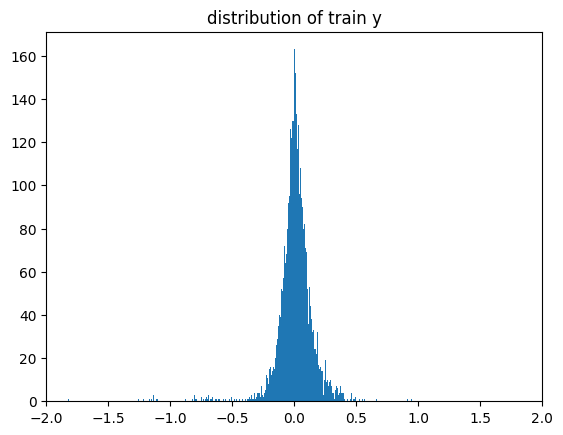

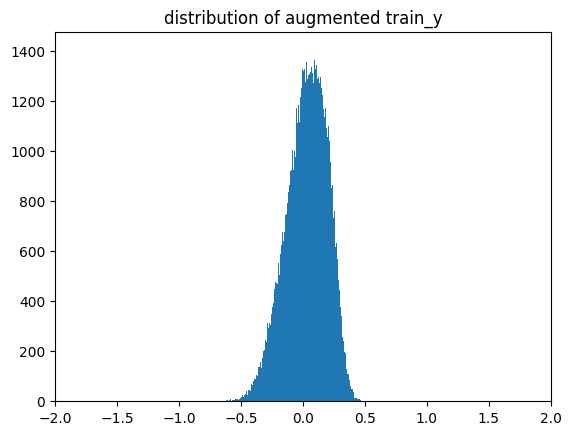

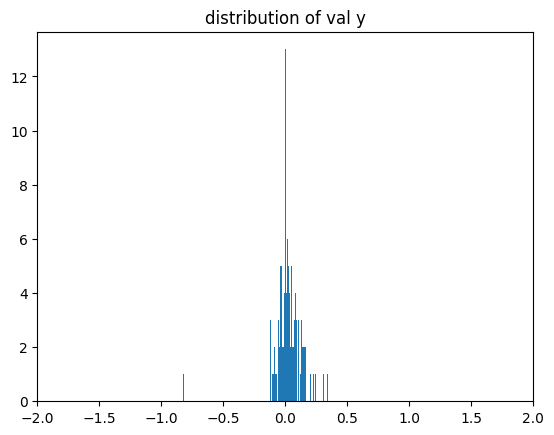

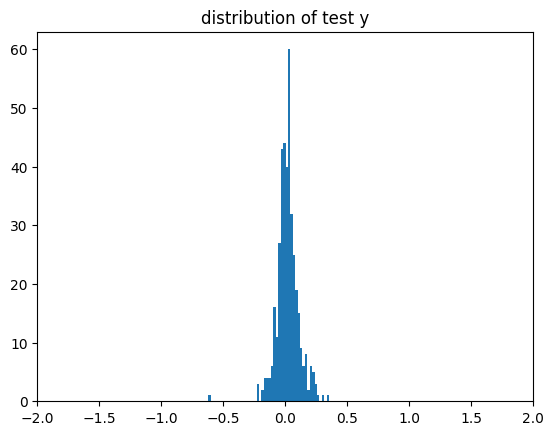

In [55]:

plt.title('distribution of train y')
plt.xlim(-2,2)
plt.hist(train_y,bins = 500)
train_y.shape
plt.show()

plt.title('distribution of augmented train_y')
plt.xlim(-2,2)
plt.hist(aug_train_y,bins = 500)
plt.show()

plt.title('distribution of val y')
plt.xlim(-2,2)
plt.hist(val_y,bins = 500)
plt.show()

plt.title('distribution of test y')
plt.xlim(-2,2)
plt.hist(test_y,bins = 50)
plt.show()


## Modeling with augmented data

In [58]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = LSTMSelfAttention(input_size=X_tensor.shape[2], hidden_size=128)
loss_fn = MAEloss()  # Assuming MSE loss for time series
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
early_stopping = EarlyStopping(patience=3)


In [ ]:

aug_train_losses, aug_train_preds, aug_val_losses, aug_val_preds = train_model(
    model, aug_train_loader, val_loader, loss_fn, optimizer, device, early_stopping, num_epochs = 30
)


  3%|▎         | 1/30 [05:42<2:45:46, 343.00s/it]

Epoch 1/30 - Train Loss: 0.0674 - Validation loss: 0.2675


  7%|▋         | 2/30 [12:15<2:53:36, 372.00s/it]

Epoch 2/30 - Train Loss: 0.0680 - Validation loss: 0.2294


 10%|█         | 3/30 [18:46<2:51:17, 380.64s/it]

Epoch 3/30 - Train Loss: 0.0676 - Validation loss: 0.1900


In [ ]:
# Save generator and discriminator state_dict
torch.save(model.state_dict(), f"LSTM_self_attention_wgan.pth")
files.download(f"LSTM_self_attention_wgan.pth")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import files

uploaded = files.upload()  # This opens a file picker dialog to upload files from your PC

# After uploading, the files are accessible by their filename in the Colab VM
lstm_path = "LSTM_05-28.pth"


# Then load:
model.load_state_dict(torch.load(lstm_path))


KeyboardInterrupt: 

In [42]:
def get_preds(model, data_loader, device):
    preds = []
    with torch.no_grad():
        for X_batch, _ in data_loader:  # assuming loader yields (inputs, targets)
            X_batch = X_batch.to(device)
            output = model(X_batch)
            preds.append(output.cpu())
    return torch.cat(preds)

aug_train_preds = get_preds(model, aug_train_loader, device)
aug_val_preds = get_preds(model, val_loader, device)

NameError: name 'model' is not defined

<ipython-input-217-b5a7091aad5e>:6: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  residuals = actual - predicted


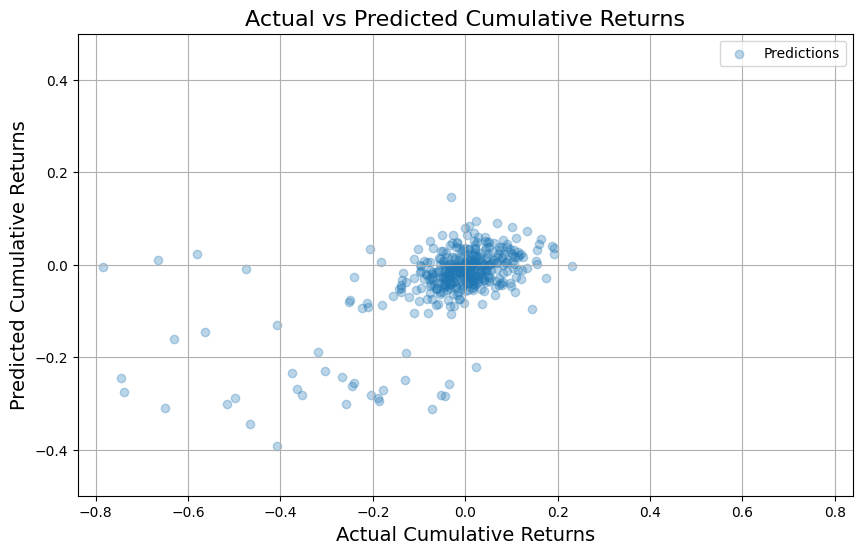

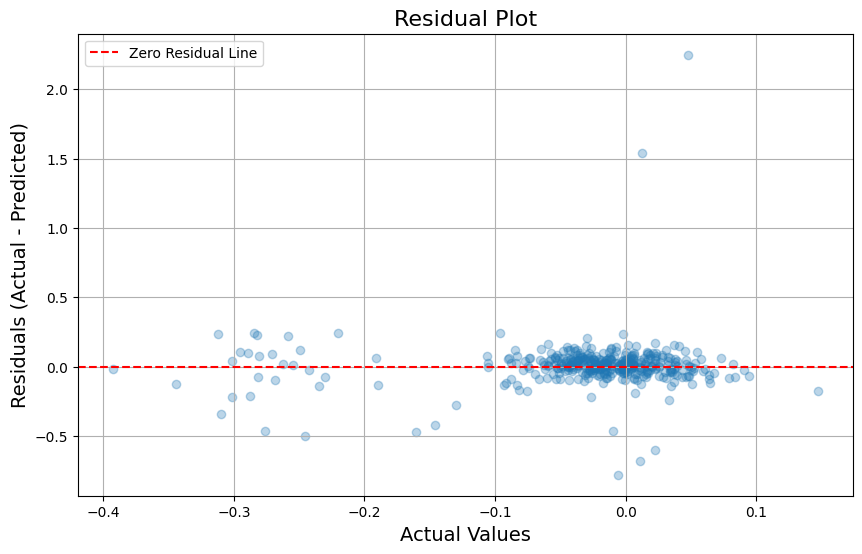

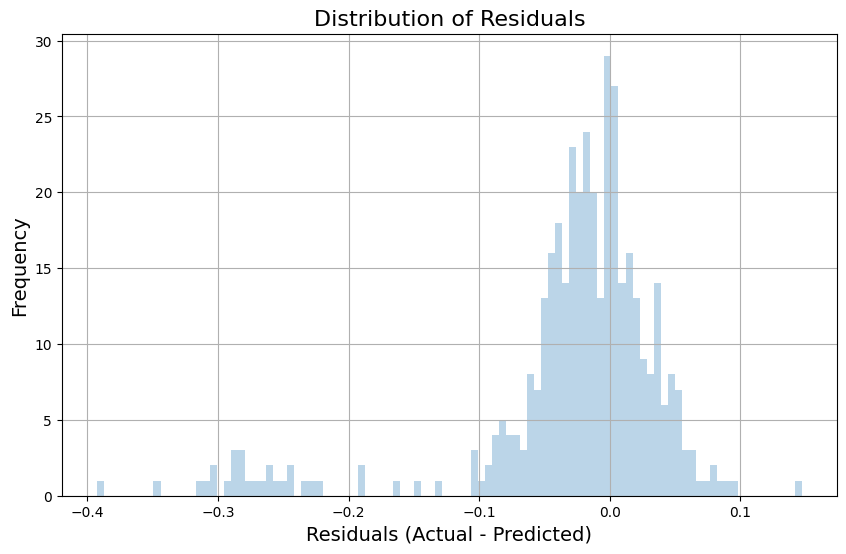

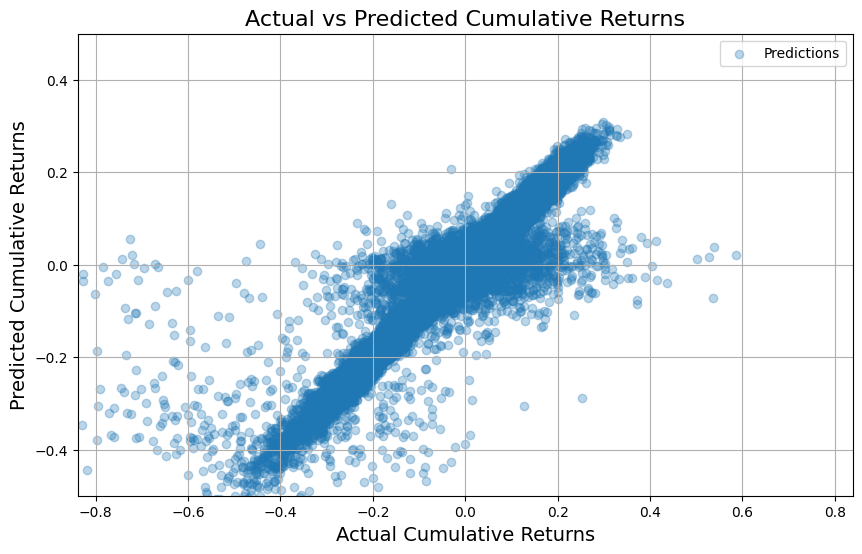

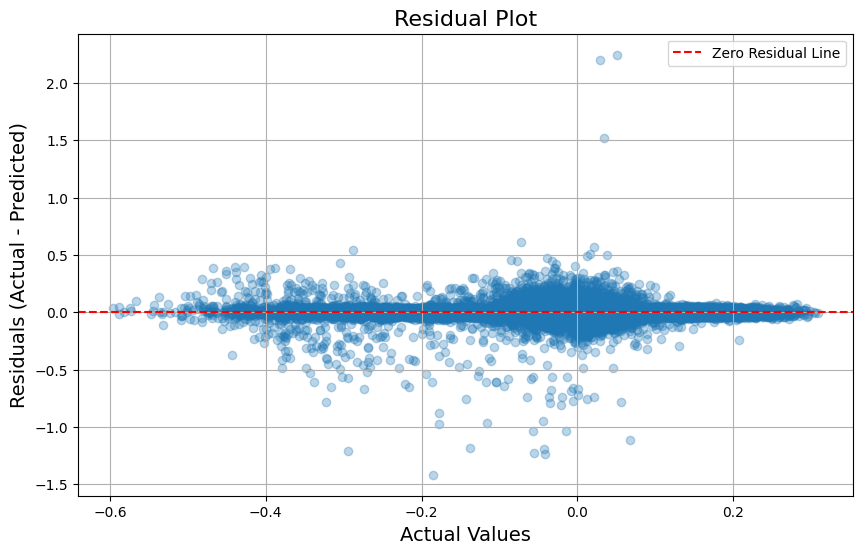

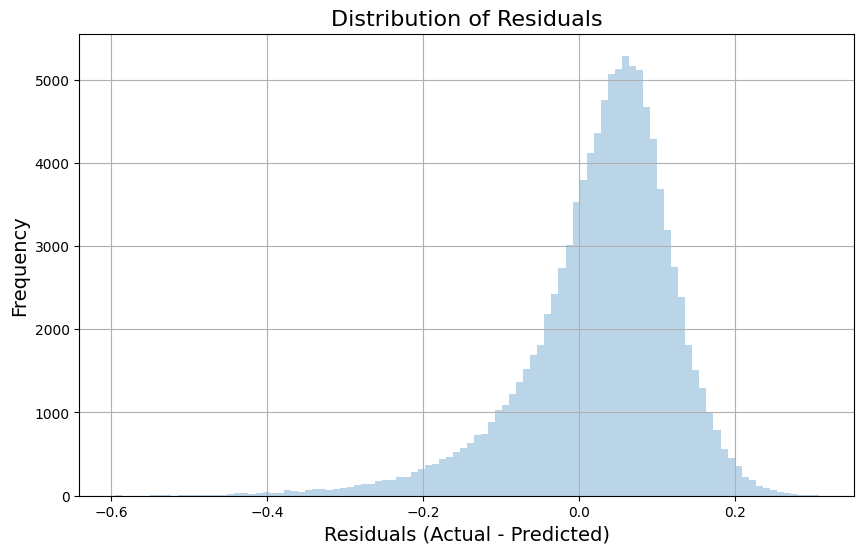

In [ ]:
aug_val_preds[-1]
plot_model_perf(val_y, aug_val_preds[-1])
plot_model_perf(aug_train_y, aug_train_preds[-1])

In [ ]:
model.eval()  # important: sets dropout/batchnorm to eval mode
predictions = []
actuals = []

with torch.no_grad():  # no gradients = no training
    for X_batch, y_batch in aug_train_loader:
        output = model(X_batch)  # shape: (batch_size,) — predicted cumulative log return
        predictions.append(output)
        actuals.append(y_batch)  # target cumulative log return

# Concatenate and flatten all batches
predictions_flat = torch.cat(predictions).cpu().numpy().flatten()
actuals_flat = torch.cat(actuals).cpu().numpy().flatten()

# Convert from cumulative log returns to normal cumulative returns
preds_norm = np.exp(predictions_flat) - 1
actuals_norm = np.exp(actuals_flat) - 1

print("Sample predicted cumulative returns:", preds_norm[:5])
print("Sample actual cumulative returns:", actuals_norm[:5])


Sample predicted cumulative returns: [-0.00275683 -0.07775998 -0.00793064  0.07876945 -0.01758152]
Sample actual cumulative returns: [-0.04524183 -0.10469317  0.08386886  0.02944243 -0.08007389]


## Bootstrap sampling from tail

In [21]:
data = train_y

mean = data.mean()
std = data.std()

left_threshold = mean - 2 * std
right_threshold = mean + 2 * std

left_tail_fraction = (data < left_threshold).sum().item() / data.size(0)
right_tail_fraction = (data > right_threshold).sum().item() / data.size(0)

left_weight = 1 / left_tail_fraction if left_tail_fraction > 0 else 1.0
right_weight = 1 / right_tail_fraction if right_tail_fraction > 0 else 1.0

In [93]:
X_tensor.shape

torch.Size([5148, 60, 5])

In [70]:
print(f'left tail fraction: {left_tail_fraction}')
print(f'right tail fraction: {right_tail_fraction}')

left tail fraction: 0.04178002331908278
right tail fraction: 0.006607073455110766


In [35]:
def bootstrap_and_oversample_tails(train_X, train_y, tail_quantile=0.01, oversample_factor=2):
    y_sum = train_y.cpu().numpy()

    left_threshold = np.quantile(y_sum, tail_quantile)
    right_threshold = np.quantile(y_sum, 1 - tail_quantile)

    # Indices in tails
    left_tail_indices = np.where(y_sum <= left_threshold)[0]
    right_tail_indices = np.where(y_sum >= right_threshold)[0]
    tail_indices = np.concatenate([left_tail_indices, right_tail_indices])

    print(f"Original tail sequences count: {len(tail_indices)}")

    # How many tail samples to generate (oversampling)
    n_tail_samples = int(oversample_factor * len(tail_indices))

    # Sample with replacement from tail indices only
    sampled_indices = np.random.choice(tail_indices, size=n_tail_samples, replace=True)

    # Convert indices to tensors
    sampled_indices_tensor = torch.tensor(sampled_indices, dtype=torch.long)

    # Select tail sequences
    tail_X_oversampled = train_X[sampled_indices_tensor]
    tail_y_oversampled = train_y[sampled_indices_tensor]


    # Concatenate oversampled tail sequences with original data
    combined_X = torch.cat([train_X, tail_X_oversampled], dim=0)
    combined_y = torch.cat([train_y, tail_y_oversampled], dim=0)

    print(f"Total sequences after oversampling tails: {combined_X.shape[0]}")

    return combined_X, combined_y

# Example usage:

combined_train_X, combined_train_y = bootstrap_and_oversample_tails(train_X, train_y, tail_quantile=0.01, oversample_factor=5)

bootstrap_train_dataset = TensorDataset(combined_train_X, combined_train_y)

# Create DataLoaders for both train and test sets
bootstrap_train_loader = DataLoader(bootstrap_train_dataset, batch_size=64, shuffle=False)

print(combined_train_X.shape)

Original tail sequences count: 104
Total sequences after oversampling tails: 5666
torch.Size([5666, 60, 5])


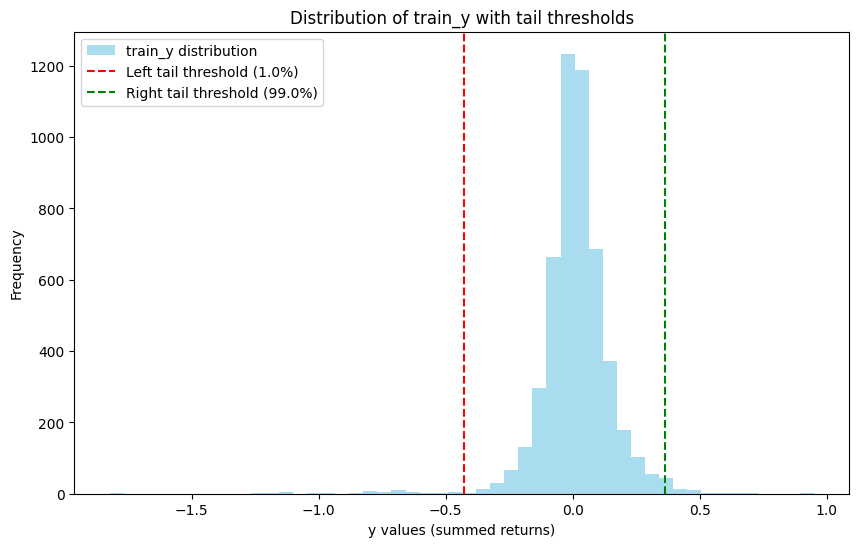

In [23]:
y_vals = train_y.cpu().numpy()  # Convert tensor to numpy array

# Calculate tail quantiles
tail_quantile = 0.01
left_threshold = np.quantile(y_vals, tail_quantile)
right_threshold = np.quantile(y_vals, 1 - tail_quantile)

plt.figure(figsize=(10,6))
plt.hist(y_vals, bins=50, alpha=0.7, color='skyblue', label='train_y distribution')

# Plot vertical lines for tail thresholds
plt.axvline(left_threshold, color='red', linestyle='--', label=f'Left tail threshold ({tail_quantile*100:.1f}%)')
plt.axvline(right_threshold, color='green', linestyle='--', label=f'Right tail threshold ({(1-tail_quantile)*100:.1f}%)')

plt.title("Distribution of train_y with tail thresholds")
plt.xlabel("y values (summed returns)")
plt.ylabel("Frequency")
plt.legend()
plt.show()

In [36]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = LSTMForecast(input_size=X_tensor.shape[2], hidden_size=128)
#loss_fn = MAELoss()  # Assuming MSE loss for time series

loss_fn = MAEloss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
early_stopping = EarlyStopping(patience=6)


train_losses_b, train_preds_b, val_losses_b, val_preds_b = train_model(
    model, bootstrap_train_loader, val_loader, loss_fn, optimizer, device , early_stopping, num_epochs=50
)


  2%|▏         | 1/50 [00:15<13:01, 15.95s/it]

Epoch 1/50 - Train Loss: 0.1314 - Validation loss: 0.0897


  4%|▍         | 2/50 [00:33<13:30, 16.89s/it]

Epoch 2/50 - Train Loss: 0.1343 - Validation loss: 0.0788


  6%|▌         | 3/50 [00:49<13:00, 16.60s/it]

Epoch 3/50 - Train Loss: 0.1325 - Validation loss: 0.0746


  8%|▊         | 4/50 [01:05<12:33, 16.37s/it]

Epoch 4/50 - Train Loss: 0.1310 - Validation loss: 0.0749


 10%|█         | 5/50 [01:25<13:12, 17.61s/it]

Epoch 5/50 - Train Loss: 0.1313 - Validation loss: 0.0734


 12%|█▏        | 6/50 [01:48<14:13, 19.41s/it]

Epoch 6/50 - Train Loss: 0.1307 - Validation loss: 0.0734


 14%|█▍        | 7/50 [02:04<13:13, 18.44s/it]

Epoch 7/50 - Train Loss: 0.1300 - Validation loss: 0.0735


 16%|█▌        | 8/50 [02:21<12:31, 17.90s/it]

Epoch 8/50 - Train Loss: 0.1303 - Validation loss: 0.0720


 18%|█▊        | 9/50 [02:38<12:00, 17.58s/it]

Epoch 9/50 - Train Loss: 0.1293 - Validation loss: 0.0738


 20%|██        | 10/50 [02:54<11:27, 17.18s/it]

Epoch 10/50 - Train Loss: 0.1298 - Validation loss: 0.0720


 22%|██▏       | 11/50 [03:10<10:53, 16.76s/it]

Epoch 11/50 - Train Loss: 0.1291 - Validation loss: 0.0738


 24%|██▍       | 12/50 [03:27<10:41, 16.87s/it]

Epoch 12/50 - Train Loss: 0.1287 - Validation loss: 0.0735


 26%|██▌       | 13/50 [03:44<10:22, 16.82s/it]

Epoch 13/50 - Train Loss: 0.1283 - Validation loss: 0.0740


 26%|██▌       | 13/50 [04:00<11:24, 18.51s/it]

Epoch 14/50 - Train Loss: 0.1284 - Validation loss: 0.0724
Early stopping triggered.


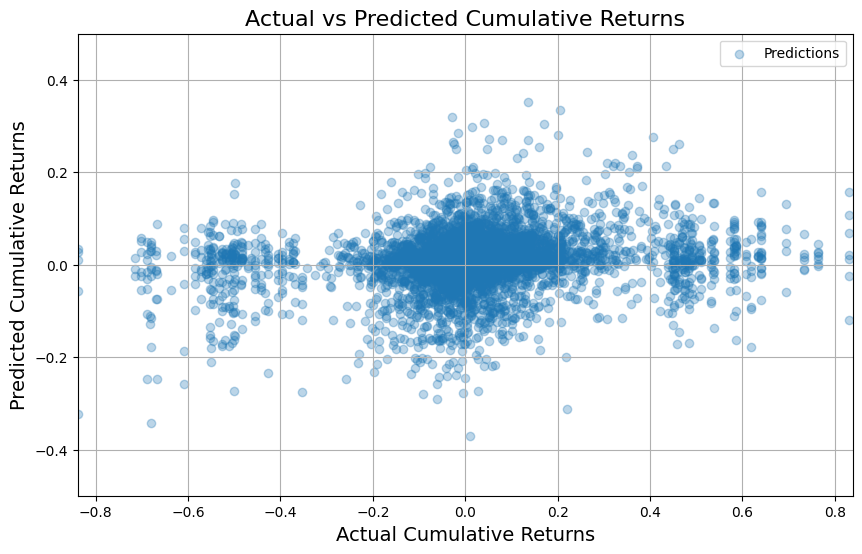

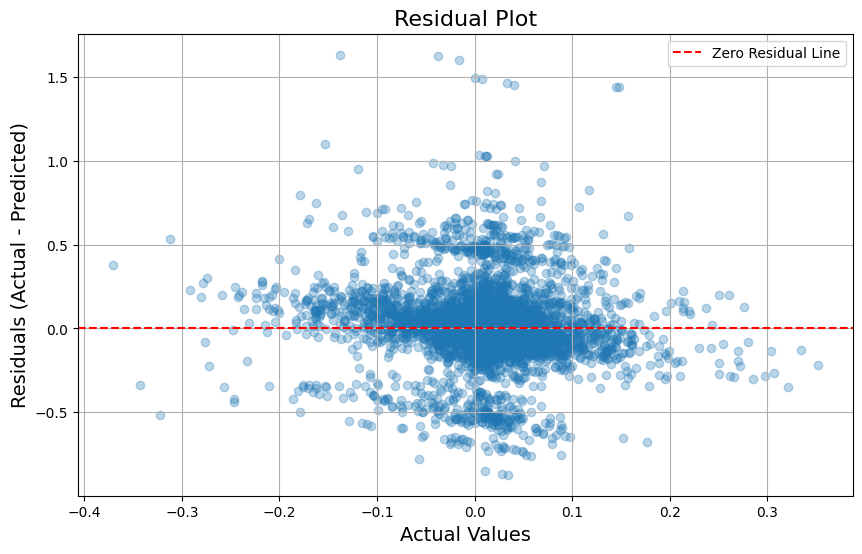

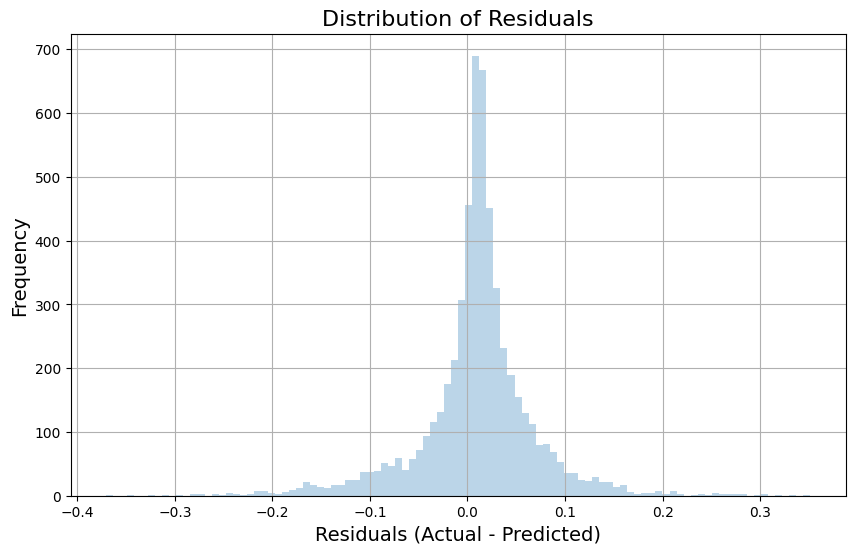

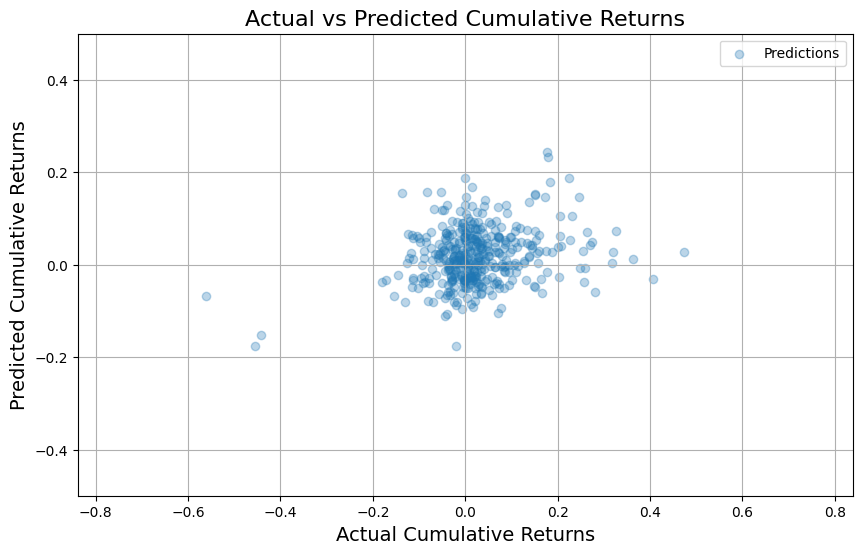

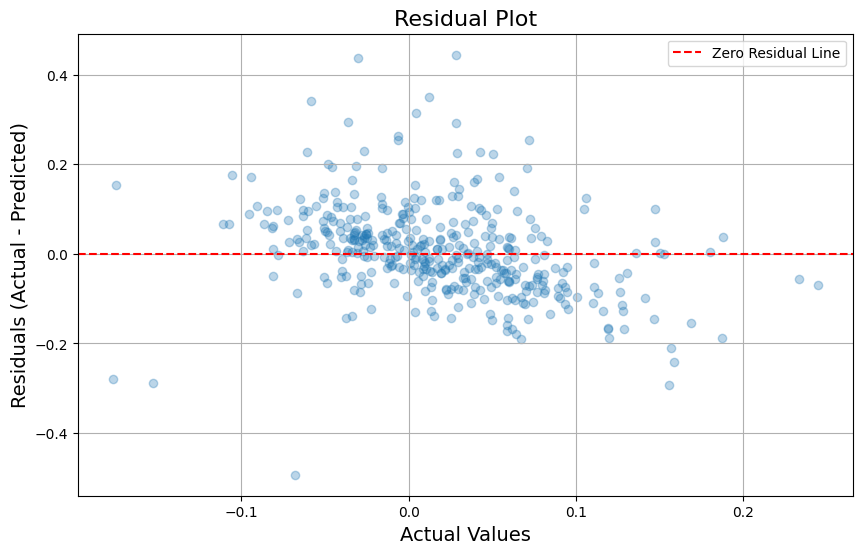

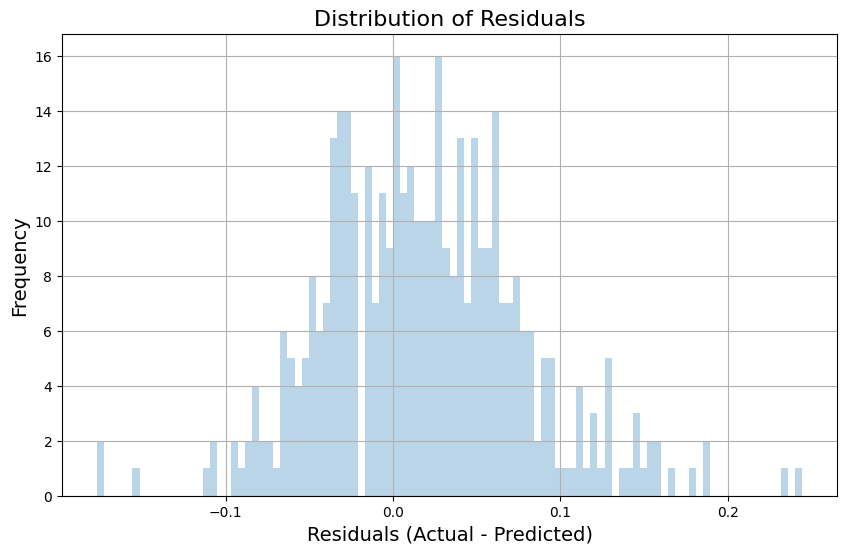

In [40]:
y_train_bootstrap = (np.exp(combined_train_y.numpy())-1)
y_train_pred = (np.exp(train_preds_b[1])-1)

y_val_bootstrap = (np.exp(val_y.numpy())-1)
y_val_pred = (np.exp(val_preds_b[1])-1)

plot_model_perf(y_train_bootstrap, y_train_pred)
plot_model_perf(y_val_bootstrap, y_val_pred)

In [44]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = LSTMForecast(input_size=X_tensor.shape[2], hidden_size=128)
#loss_fn = MAELoss()  # Assuming MSE loss for time series

loss_fn = MAEloss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
early_stopping = EarlyStopping(patience=6)

train_losses_vanilla, train_preds_vanilla, val_losses_vanilla, val_preds_vanilla = train_model(
    model, train_loader, val_loader, loss_fn, optimizer, device , early_stopping, num_epochs=50
)

  2%|▏         | 1/50 [00:15<12:33, 15.37s/it]

Epoch 1/50 - Train Loss: 0.0880 - Validation loss: 0.0622


  4%|▍         | 2/50 [00:30<12:01, 15.04s/it]

Epoch 2/50 - Train Loss: 0.0850 - Validation loss: 0.0609


  6%|▌         | 3/50 [00:45<11:48, 15.08s/it]

Epoch 3/50 - Train Loss: 0.0833 - Validation loss: 0.0603


  8%|▊         | 4/50 [01:00<11:27, 14.94s/it]

Epoch 4/50 - Train Loss: 0.0836 - Validation loss: 0.0604


 10%|█         | 5/50 [01:14<11:09, 14.89s/it]

Epoch 5/50 - Train Loss: 0.0827 - Validation loss: 0.0609


 10%|█         | 5/50 [01:23<12:33, 16.75s/it]


KeyboardInterrupt: 

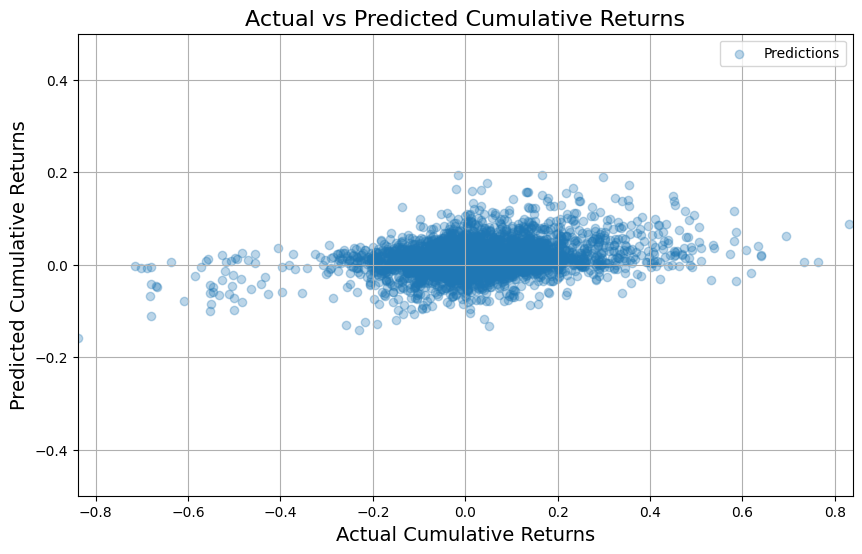

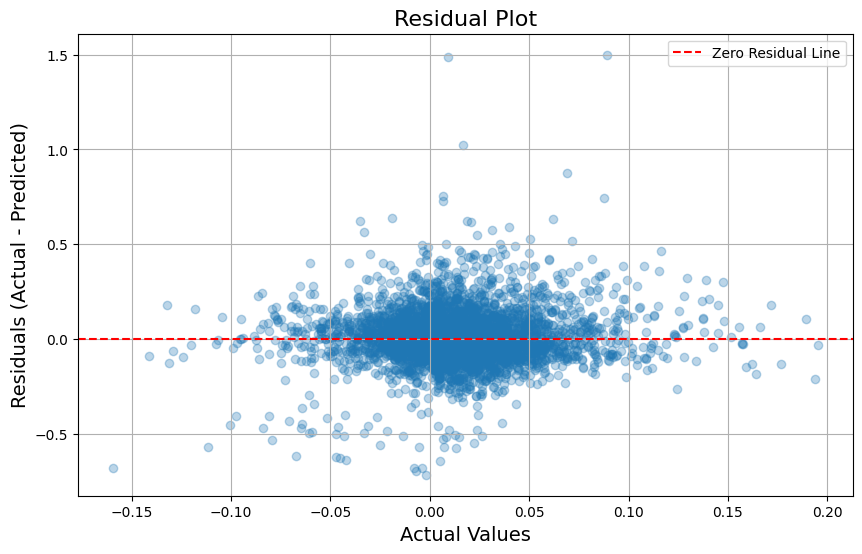

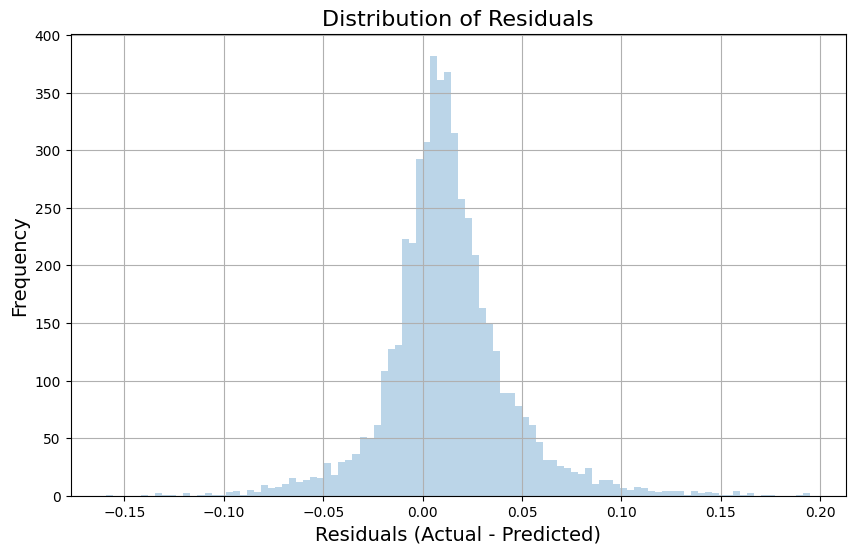

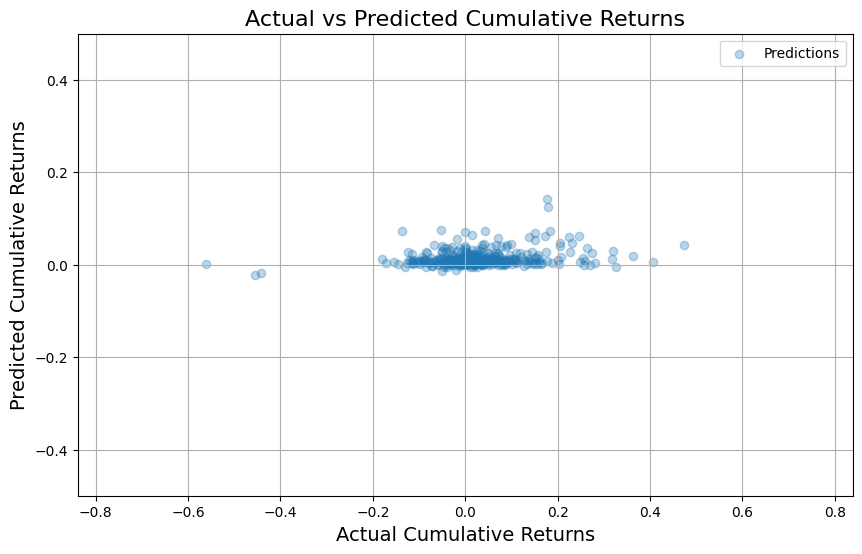

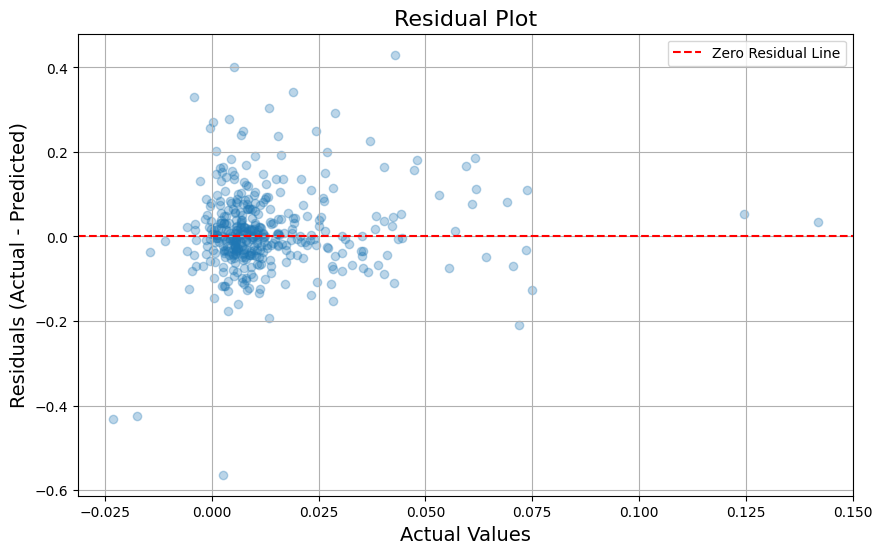

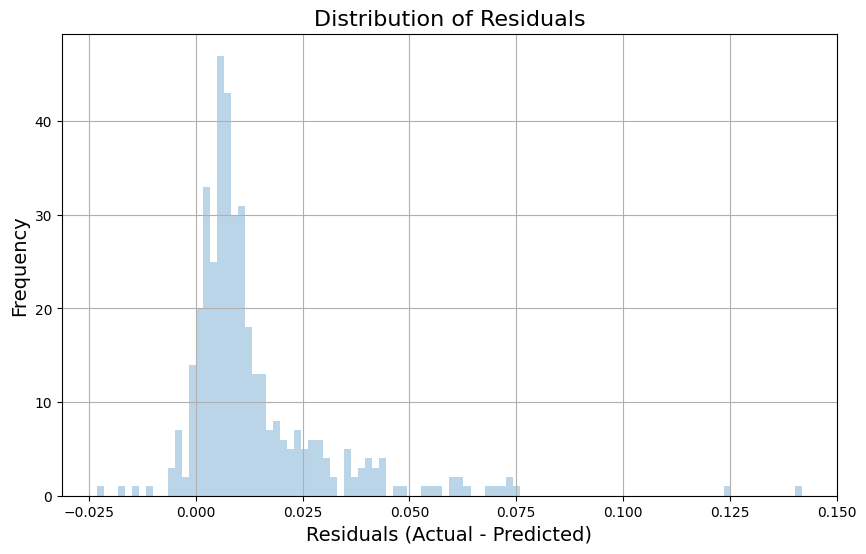

In [37]:
y_train_vanilla = (np.exp(train_y.numpy())-1)
y_train_pred = (np.exp(train_preds_vanilla[1])-1)

y_val_vanilla = (np.exp(val_y.numpy())-1)
y_val_pred = (np.exp(val_preds_vanilla[1])-1)

plot_model_perf(y_train_vanilla, y_train_pred)
plot_model_perf(y_val_vanilla, y_val_pred)